# Datos del alumno

**Nombre**: Pascal


**Apellidos**: Seihon


**Grupo:**

 Recordamos que el objetivo de este proyecto es predecir si un trabajador va a abandonar la empresa o no (variable `left`).

El objetivo de este sprint es entrenar 3 árboles de decisión:


*   Uno sin aplicar ningún criterio de poda (sin hiperparámetros)
*   Otros dos especificando diferentes hiperparámetros.

Para este caso continuaremos con los datos empleados en secciones anteriores.

Lo primero de todo será importar las librerías necesarias.

In [470]:
import os
import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
import numpy as np
import pandas as pd
import seaborn as sns
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (accuracy_score,
                             f1_score,
                             roc_auc_score,
                             roc_curve,
                             confusion_matrix,
                             classification_report)
from sklearn.model_selection import (cross_val_score,
                                     GridSearchCV,
                                     RandomizedSearchCV,
                                     learning_curve,
                                     validation_curve,
                                     train_test_split)
from sklearn.pipeline import make_pipeline
from sklearn.utils import resample
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')

%matplotlib inline

Y las específicas para este sprint.

In [471]:
##Si no habéis instalado previamente la librería, tenéis que descomentar la siguiente línea para descargar dtreeviz
!pip install dtreeviz

In [472]:
from sklearn import tree
import dtreeviz
from sklearn.tree import export_text

# Estudio descriptivo de los datos.

En este apartado vamos a familiarizarnos con la estructura que toman estos datos, así como con las diversas características de los mismos y posibles relaciones entre ellos.

Lo primero que hacemos es importar las librerías que vamos a necesitar y los datos en cuestión.

In [473]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
%matplotlib inline

In [474]:
#Descarga manual: https://drive.google.com/file/d/1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK/view?usp=sharing
#Descargamos los ficheros de Google Drive
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK' -O 'Rotacion_empleados.csv'

--2025-03-05 23:04:55--  https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK
Resolving drive.google.com (drive.google.com)... 172.253.62.138, 172.253.62.101, 172.253.62.139, ...
Connecting to drive.google.com (drive.google.com)|172.253.62.138|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download [following]
--2025-03-05 23:04:55--  https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 172.253.122.132, 2607:f8b0:4004:c09::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|172.253.122.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 551779 (539K) [application/octet-stream]
Saving to: ‘Rotacion_empleados.csv’

Rotacion_empleados. 100%[===================>] 538.85K 

Si no conseguís descargar el fichero con el anterior comando, también lo tenéis a vuestra disposición en los **Recursos del proyecto** con el nombre `Rotacion_empleados.csv`.

In [475]:
# Leemos el conjunto de datos
datos = pd.read_csv("Rotacion_empleados.csv")

In [476]:
# obtenemos las filas y columnas qu contiene
datos.shape

(14999, 10)

In [477]:
datos.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years', 'sales', 'salary'],
      dtype='object')

In [478]:
# Veamos los primeros datos
datos.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,sales,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


In [479]:
#obtenemos información sobre las variables que contiene este data set
datos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14999 entries, 0 to 14998
Data columns (total 10 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   satisfaction_level     14999 non-null  float64
 1   last_evaluation        14999 non-null  float64
 2   number_project         14999 non-null  int64  
 3   average_montly_hours   14999 non-null  int64  
 4   time_spend_company     14999 non-null  int64  
 5   Work_accident          14999 non-null  int64  
 6   left                   14999 non-null  int64  
 7   promotion_last_5years  14999 non-null  int64  
 8   sales                  14999 non-null  object 
 9   salary                 14999 non-null  object 
dtypes: float64(2), int64(6), object(2)
memory usage: 1.1+ MB


**Significado y contenido de las variables.**

* **satisfaction_level**: Es el nivel de satisfacción de los empleados, que va de 0-1.

* **last_evaluation**: Se evalúa el desempeño por parte del empleador, el cual también va de 0-1..

* **number_projects**: ¿Cual es el  número de proyectos asignados a un empleado?

* **average_monthly_hours**: ¿Cuántas horas promedio trabaja un empleado en un mes?

* **time_spent_company**: significa experiencia del empleado. Número de años de permanencia de un empleado en la empresa.

* **work_accident**: si un empleado ha tenido un accidente de trabajo o no.

* **promotion_last_5years**: si un empleado ha tenido una promoción en los últimos 5 años o no..

* **sales**: departamento/división a la que pertenece el empleado.

* **Salary**: Nivel salarial del empleado en los niveles:low, medium and high.

* **left**: Si el empleado ha dejado la empresa o no. (0: No, 1: Sí)

Observemos que la variable con denominación "sales" no expresa adecuadamente el contenido de la variable, quizá sea más procedente denominarla `department`, que es lo que hacemos a continuación.

In [480]:
datos.rename(columns={'sales': 'department'}, inplace=True)
datos.head()

,satisfaction_level,last_evaluation,number_project,average_montly_hours,time_spend_company,Work_accident,left,promotion_last_5years,department,salary
0,0.38,0.53,2,157,3,0,1,0,sales,low
1,0.80,0.86,5,262,6,0,1,0,sales,medium
2,0.11,0.88,7,272,4,0,1,0,sales,medium
3,0.72,0.87,5,223,5,0,1,0,sales,low
4,0.37,0.52,2,159,3,0,1,0,sales,low


## Análisis descriptivo de los datos


Evaluamos el porcentaje de empleados que pertenencen a cada uno de los departamentos (variable que anteriormente se llamaba `sales`y ahora se llama `department`).

In [481]:
datos.department.value_counts(normalize=True)

,proportion
department,
sales,0.276018
technical,0.181345
support,0.148610
IT,0.081805
product_mng,0.060137
marketing,0.057204
RandD,0.052470
accounting,0.051137
hr,0.049270


Los datos anteriores en formato de gráfico, los obtendremos de la siguiente manera:

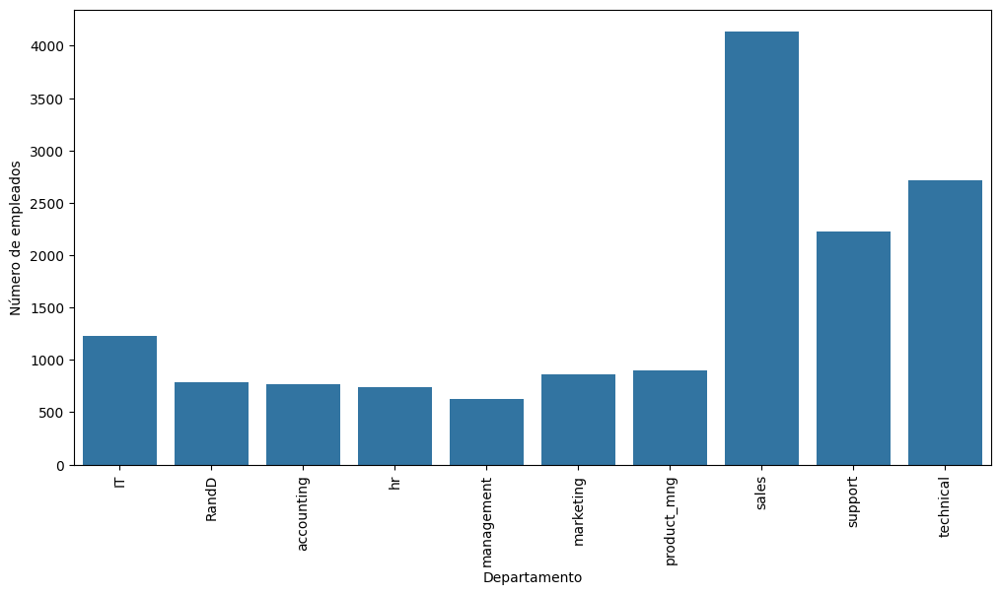

In [482]:
plt.figure(figsize=(12,6))
data_group = datos.groupby(by=['department'],as_index=False).count()
ax = sns.barplot(x="department", y="left", data=data_group)
ax.set(xlabel='Departamento', ylabel='Número de empleados')

plt.xticks(rotation = 90);

Podemos ver que casi un 30% de los empleados presentes en la muestra pertenecen al departamento de ventas.

Listar columnas

In [483]:
datos.columns

Index(['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years', 'department', 'salary'],
      dtype='object')

Analisemos los variables estadisticos (ccolumnas numericas) de nuestro dataset.

In [484]:
datos.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
satisfaction_level,14999.0,0.612834,0.248631,0.09,0.44,0.64,0.82,1.0
last_evaluation,14999.0,0.716102,0.171169,0.36,0.56,0.72,0.87,1.0
number_project,14999.0,3.803054,1.232592,2.00,3.00,4.00,5.00,7.0
average_montly_hours,14999.0,201.050337,49.943099,96.00,156.00,200.00,245.00,310.0
time_spend_company,14999.0,3.498233,1.460136,2.00,3.00,3.00,4.00,10.0
Work_accident,14999.0,0.144610,0.351719,0.00,0.00,0.00,0.00,1.0
left,14999.0,0.238083,0.425924,0.00,0.00,0.00,0.00,1.0
promotion_last_5years,14999.0,0.021268,0.144281,0.00,0.00,0.00,0.00,1.0


Destectar y contar los valores nulos en las columnas del DataFrame


In [485]:
datos.isnull().sum().T

,0
satisfaction_level,0
last_evaluation,0
number_project,0
average_montly_hours,0
time_spend_company,0
Work_accident,0
left,0
promotion_last_5years,0
department,0
salary,0


Obtener el histograma para cada una de las variables

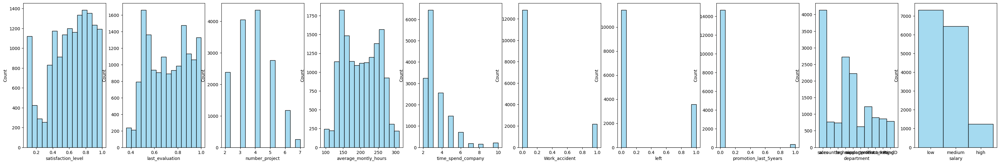

In [486]:
import matplotlib.pyplot as plt
import seaborn as sns

# Lista de las variables
variables = ['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years', 'department', 'salary']

# Crear un histograma para cada variable
plt.figure(figsize=(40, 6))

for i, var in enumerate(variables, 1):
    plt.subplot(1, 10, i)
    sns.histplot(datos[var], kde=False, bins=15, color='skyblue')
    plt


Obtener un gráfico box-plot para las variables

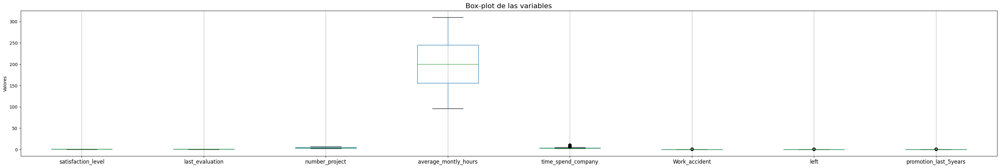

In [487]:
# Lista de las variables
variables = ['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident', 'left',
       'promotion_last_5years']

# Crear un histograma para cada variable

# Crear box-plot
plt.figure(figsize=(40, 6))
datos[variables].boxplot()
plt.title("Box-plot de las variables", fontsize=16)
plt.ylabel("Valores")
plt.xticks(rotation=0, fontsize=12)
plt.grid(axis='y')
plt.show()

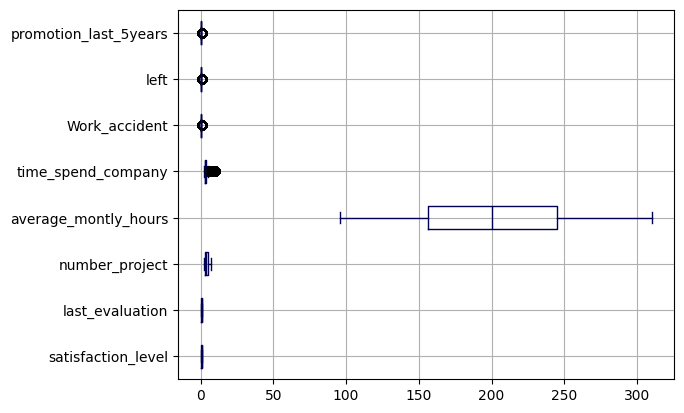

In [488]:
# BOX PLOT
dfplox = datos.boxplot(vert=False, color = "#000054")

MATRIZ DE CORRELACIONES de las variables explicativas

<Axes: >

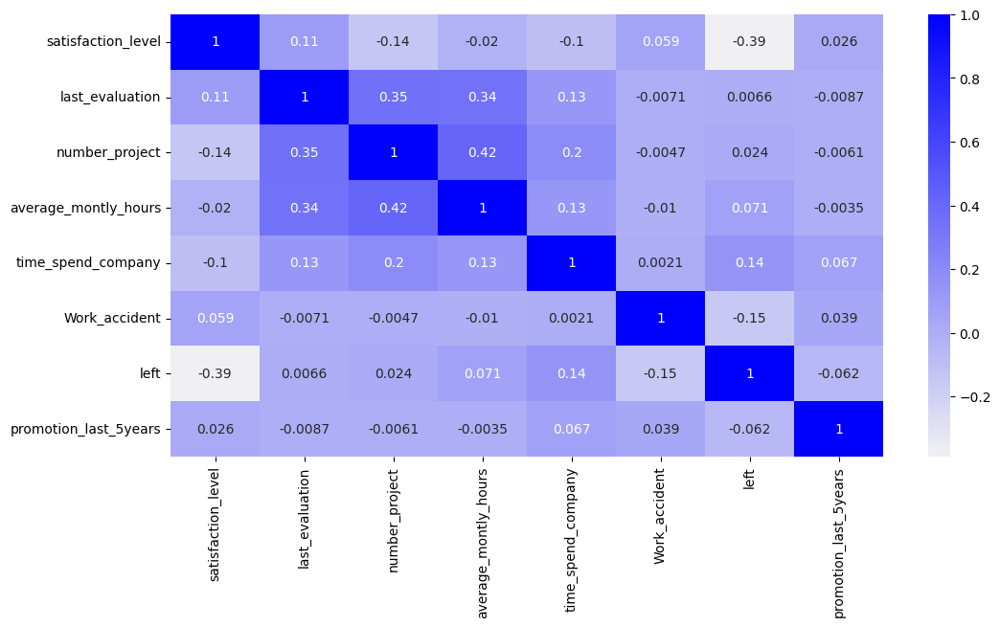

In [489]:
midatos = datos.drop(columns=['department','salary'])
plt.figure(figsize=(12,6))
corr = midatos.corr()
cmap = sns.color_palette("light:b", as_cmap=True)
sns.heatmap(corr, annot=True, cmap=cmap)

**La variable "left" se elige como la variable a predecir ya que indica si un empleado ha dejado la empresa o no.**

**left = 1 → El empleado dejó la empresa.**

**left = 0 → El empleado sigue en la empresa.**

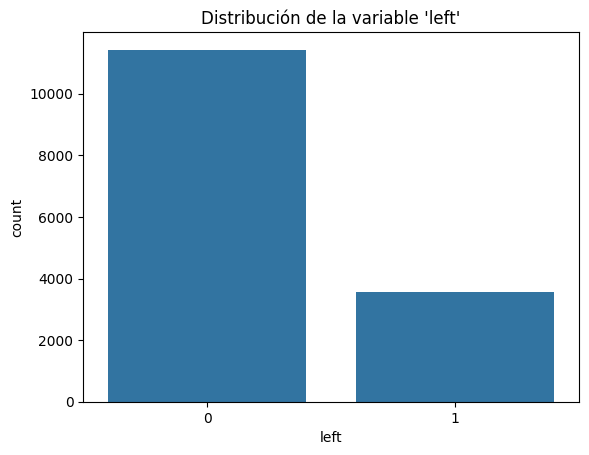

In [490]:
# Visualización de la variable a predecir (left)
sns.countplot(x='left', data=datos)
plt.title("Distribución de la variable 'left'")
plt.show()


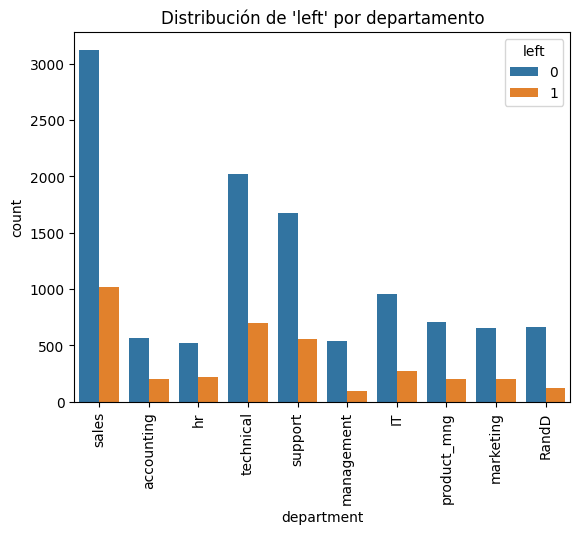

In [491]:
# Distribución de 'left' en cada categoría de 'department'
sns.countplot(x='department', hue='left', data=datos)
plt.xticks(rotation=90)
plt.title("Distribución de 'left' por departamento")
plt.show()

In [ ]:
# Lista de las variables
variables = ['satisfaction_level', 'last_evaluation', 'number_project',
       'average_montly_hours', 'time_spend_company', 'Work_accident',
       'promotion_last_5years', 'department', 'salary']

# Crear un histograma para cada variable
plt.figure(figsize=(40, 6))

for i, var in enumerate(variables, 1):
    plt.subplot(1, 10, i)
    sns.boxplot(x='left', y=var, data=datos)
    plt


In [ ]:
# Contar el número de empleados que se quedaron y los que se fueron
sns.countplot(x='left', data=datos)
plt.title("Distribución de empleados que dejaron o no la empresa")
plt.xlabel("Left (0 = No, 1 = Sí)")
plt.ylabel("Número de empleados")
plt.show()


Estamos ante un problema de clases **desbalanceadas**, ya que la cantidad de empleados que permanecieron en la empresa es significativamente mayor que la cantidad de empleados que la abandonaron

In [ ]:
#Estudiar cómo se ditribuye la variable `left`en función de los siguientes atributos categóricos: `number_project`,`time_spend_company`,`Work_accident`,`department`, `promotion_last_5years`,`salary`.
# Distribución de 'left'  con las variables:
#Lista de las variables
variables = ['number_project','time_spend_company','Work_accident','department', 'promotion_last_5years','salary']

# Crear un histograma para cada variable
plt.figure(figsize=(40, 6))

for i, var in enumerate(variables, 1):
    plt.subplot(1, 10, i)
    sns.countplot(x=var, hue='left', data=datos)
    plt.xticks(rotation=90)
    plt.title(f"left VS {var}")
    plt


## Análisis predictivo

**Preparación de los datos**

Lo primero de todo, vamos a ver el tipo de variables con las que estamos trabajando.

In [ ]:
datos.dtypes

Podemos observar que hay algunas variables que son de tipo categórico con categorías en formato literal (`object`). Como hemos visto en la teoría, hay algunos modelos que no admiten esta codificación de las categorías, por lo que las transformamos a formato numérico.

La variable `salary`(salario) sí que podemos considerarla como de tipo ordinal. Sin embargo, esto no aplica a la variable `department`. A esta variable habrá que transformarla en variables de tipo dummy.

In [ ]:

#  Transformar la variable `salary` de forma que sus categorías se codifiquen de la siguiente manera: low = 0, medium = 1 y high = 2.
#  Transformar la variable `department` en variables dummies.


#Puedes volver a revisar el vídeo de la Clase 1 Tema 4 - **Laboratorio Preprocesamiento de datos: parte 2**, donde a partir del minuto 5:55 se explica en detalle cómo proceder en estos casos.

# Transformar la variable salary en valores numéricos
salary_mapping = {'low': 0, 'medium': 1, 'high': 2}
datos['salary'] = datos['salary'].map(salary_mapping)
# Transformar la variable department en variables dummies
datos = pd.get_dummies(datos, columns=['department'], drop_first=True)

In [ ]:
datos.head()

**Con las premisas anteriores obtener los conjuntos de train y test, de manera que el tamaño del conjunto del test tenga el 20% de observaciones sobre el conjunto total, y utilizando el parámetro random_state=123.**

*NOTA*. Para que la celda posterior en la que guardamos los datos funcione, recomendamos llamar a los conjuntos de train y test resultantes de la siguiente manera: `X_train`, `X_test`, `y_train`, `y_test`.

In [ ]:
# ENTRENAMIENTO Y TEST
from sklearn.model_selection import train_test_split
X = datos.loc[:, datos.columns != "left"]
y = datos.loc[:, datos.columns == "left"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

# Sprint 1

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

## CUESTION 1

**¡Ahora es tu turno! Responde a las siguientes preguntas con los gráficos que consideres más adecuados y su explicación correspondiente:**


1.   Si queremos predecir si un empleado abandona o no la empresa, ¿estamos ante un problema de clases balanceado o desbalanceado? Justifica tu respuesta incluyendo un gráfico que represente el número observaciones en cada una de las clases.


In [ ]:
# Contar el número de empleados que se quedaron y los que se fueron
sns.countplot(x='left', data=datos)
plt.title("Distribución de empleados que dejaron o no la empresa")
plt.xlabel("Left (0 = No, 1 = Sí)")
plt.ylabel("Número de empleados")
plt.show()


Estamos ante un problema de clases **desbalanceadas**, ya que la cantidad de empleados que permanecieron en la empresa es significativamente mayor que la cantidad de empleados que la abandonaron

2.   Estudiar cómo se ditribuye la variable `left`en función de los siguientes atributos categóricos: `number_project`,`time_spend_company`,`Work_accident`,`department`, `promotion_last_5years`,`salary`.

In [ ]:
# Distribución de 'left'  con las variables:
# Verificar que las variables existen en 'datos'
variables = [var for var in variables if var in datos.columns]

# Crear histogramas solo para las variables existentes
plt.figure(figsize=(40, 6))
for i, var in enumerate(variables, 1):
    plt.subplot(1, len(variables), i)
    sns.countplot(x=var, hue='left', data=datos)
    plt.xticks(rotation=90)
    plt.title(f"left VS {var}")
plt.show()


Os facilito una serie de enlaces que os pueden servir de inspiración para realizar esta parte:



*   [Introducción a la estadística descriptiva](https://deepnote.com/@anthonymanotoa/Apuntes-de-Estadistica-Descriptiva-cfa882b6-c07f-43fe-9901-1c2e471ce120): Para aquellos que de seen introducirse a la analítica descriptiva desde cero.
*   [Análisis de datos categóricos con Python](https://relopezbriega.github.io/blog/2016/02/29/analisis-de-datos-categoricos-con-python/): Enfocado en el estudio de variables categóricas.
*   [Análisis exploratorio de datos con Python](https://www.kaggle.com/code/abonaplata/analisis-exploratorio-de-datos-con-python#AN%C3%81LISIS-EXPLORATORIO-DE-DATOS-CON-PYTHON): Estudia la relación entre variables categóricas y variables continuas.

Sin embargo, éstos no dejan de ser unos de los muchos ejemplos sobre cómo realizar el análisis exploratorio, así que tenéis total libertad para explorar y realizar cualquier análisis adicional que se os ocurra.

## CUESTION 2



*   Transformar la variable `salary` de forma que sus categorías se codifiquen de la siguiente manera: low = 0, medium = 1 y high = 2.
*   Transformar la variable `department` en variables dummies.


Puedes volver a revisar el vídeo de la Clase 1 Tema 4 - **Laboratorio Preprocesamiento de datos: parte 2**, donde a partir del minuto 5:55 se explica en detalle cómo proceder en estos casos.

In [ ]:
# Transformar la variable salary en valores numéricos
#salary_mapping = {'low': 0, 'medium': 1, 'high': 2}
#datos['salary'] = datos['salary'].map(salary_mapping)
# Transformar la variable department en variables dummies
#datos = pd.get_dummies(datos, columns=['department'], drop_first=True)

In [ ]:
datos.head()

### Implementación de los modelos

Es importante tener en cuenta que estamos ante un problema de clasifiación binaria (0: No abandona, 1: Sí abandona). Por lo tanto, de entre los 4 diferentes algoritmos que hemos visto esta semana **sólo podemos aplicar 2**
, ¿cuáles son?

En los vídeos de los laboratorios podéis encontrar una carpeta con los **recursos** de apoyo que contiene un ejemplo paso a paso sobre cómo implementar estos modelos en Python. Os animo a entenderlos bien y tratar de seguir el mismo procedimiento para estos datos.

**IMPORTANTE**: Recordad que antes de entrenar un modelo es clave particionar los datos en, al menos, dos conjuntos diferentes: uno para entrenar el modelo (train) y otro para evaluar su capacidad predictiva (test).

En este caso, empleamos el parámetro `stratify=y` para garantizar que la proporción de observaciones de la variable `left` se mantenga tanto en la partición de train como en la de test. Es decir, en ambas particiones conservamos aproximadamente la proporción de 24% observaciones de la categoría *Sí* y el 76% restante de la categoría *No*.

## CUESTION 3

Con las premisas anteriores obtener los conjuntos de train y test, de manera que el tamaño del conjunto del **test tenga el 20% de observaciones** sobre el conjunto total, y utilizando el parámetro **random_state=123**.

*NOTA*. Para que la celda posterior en la que guardamos los datos funcione, recomendamos llamar a los conjuntos de train y test resultantes de la siguiente manera: `X_train`, `X_test`, `y_train`, `y_test`.

In [ ]:
# ENTRENAMIENTO Y TEST
from sklearn.model_selection import train_test_split
X = datos.loc[:, datos.columns != "left"]
y = datos.loc[:, datos.columns == "left"]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

Estos conjuntos de entrenamiento y test los vamos a utilizar tal cual en futuros sprint, así que los guardamos de la siguiente manera:

In [ ]:
np.save("X_train",X_train)
np.save("X_test",X_test)
np.save("y_train",y_train)
np.save("y_test",y_test)

*NOTA*. Los ficheros anteriores se guardan con la extensión .npy, y así por ejemplo tendremos el fichero "X_train.npy", etc.

Si queréis conservar estas matrices, es imporante que descarguéis a vuestro PC estos archivos generados antes de cerrar la sesión de Google Colab para evitar perderlos. Sin embargo, si no lo hacéis no pasa nada, ya que en los siguientes sprints se os dará como input.

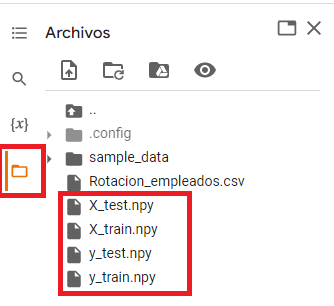

#### Carga de los conjuntos de train y test


En el anterior apartado hemos guardado los conjuntos de entrenamiento y test (son objetos de tipo np.array). Lo que deberemos hacer en los diferentes pasos tanto de este sprint como de los siguientes es recuperar estos datos para trabajar con ellos. Lo haremos con la siguiente instrucción:

In [ ]:
### Si no conseguís ejecutar los datos anteriores podeis descomentar las siguientes instrucciones para obtener las matrices resultantes

##Descarga manual: https://drive.google.com/file/d/1S7DtU2HEFXkqyJp_RcILNSgEsY3huIL9/view?usp=sharing
##Descarga manual: https://drive.google.com/file/d/1O1BRGwSd81TOOpaQvoo5BHDsrPEruz93/view?usp=sharing
##Descarga manual: https://drive.google.com/file/d/1u3yI5L_2YI77uF_WT9ysIzw8dydVlQSh/view?usp=sharing
##Descarga manual: https://drive.google.com/file/d/1eWo_m2gbihSuUQeOhH8I8Q0uudluQKBT/view?usp=sharing


##Descargamos los ficheros de Google Drive (si lo ejecutais en un entorno diferente a Google Colab, tenéis que intalar previamente wget en vuestro PC)
#!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1S7DtU2HEFXkqyJp_RcILNSgEsY3huIL9' -O 'y_train.npy'
#!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1O1BRGwSd81TOOpaQvoo5BHDsrPEruz93' -O 'y_test.npy'
#!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1u3yI5L_2YI77uF_WT9ysIzw8dydVlQSh' -O 'X_train.npy'
#!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1eWo_m2gbihSuUQeOhH8I8Q0uudluQKBT' -O 'X_test.npy'

In [ ]:
#X_train, X_test,y_train,y_test = np.load("X_train.npy"),np.load("X_test.npy"),np.load("y_train.npy"),np.load("y_test.npy")

De esta manera ya estaremos dispuestos en este sprint y en los de las siguientes semanas a trabajar con estos conjuntos de datos.

Ahora procedemos a entrenar los modelos vistos durante esta semana adecuados para predecir la variables `left`.

## CUESTION 4

**Entrenar con los datos de train y evaluar sobre datos de test dos de los algoritmos vistos en la lección para predecir si un empleado se va a ir o no de la empresa.**

#### Modelo 1 LogisticRegression

Conceptos básicos de la Regresión Logística
Como hemos visto en la teoría, la regresión logística emplea la función logit para obtener para cada observación la probabilidad de pertenecer a una clase u otra.

En la siguiente celda de código os vamos a mostrar cómo genera la función logit en Python a partir de 100 puntos igualmente distribuidos.

In [ ]:
#Generamos 100 puntos igualmente distribuidos entre -100 y 100
t = np.linspace(-10, 10, 100)
#calculamos la función sigmoidea o logit para estos puntos
sig = 1 / (1 + np.exp(-t))
#Generamos el marco del gráfico para que se puedan identificar mejor los puntos de interés
plt.figure(figsize=(9, 3))
plt.plot([-10, 10], [0, 0], "k-")
plt.plot([-10, 10], [0.5, 0.5], "k:")
plt.plot([-10, 10], [1, 1], "k:")
plt.plot([0, 0], [-1.1, 1.1], "k-")
#representamos t en el eje X y sig en el eje y
plt.plot(t, sig, "b-", linewidth=2, label=r"$\sigma(t) = \frac{1}{1 + e^{-t}}$")
plt.xlabel("t")
plt.ylabel("sig")
plt.legend(loc="upper left", fontsize=20)
plt.axis([-10, 10, -0.1, 1.1])
plt.show()

Entrenamiento del modelo de Regresión Logística

Ajustamos el modelo al conjunto de entrenamiento.

In [ ]:
from sklearn.linear_model import LogisticRegression
classifierlogistic = LogisticRegression(random_state = 0, solver='lbfgs', multi_class='auto')
classifierlogistic.fit(X_train, y_train)

**precisión del algoritmo para los conjuntos de entrenamiento y test.**

Estudiemos la precisión (accuracy) del método

In [ ]:
from sklearn.metrics import accuracy_score
# Calculo de métricas
predicciones_train = classifierlogistic.predict(X_train)
predicciones_test = classifierlogistic.predict(X_test)
print(f"Precisión en el conjunto de entrenamiento es:  {accuracy_score(y_train, predicciones_train)}")
print(f"Precisión en el conjunto de test es:  {accuracy_score(y_test, predicciones_test)}")


Normalizando el conjunto de test y train

In [ ]:
# Calculo de métricas
accuracy = accuracy_score(y_train, predicciones_train, normalize = True)
print(f"Precisión en el conjunto de entrenamiento es: {100*accuracy} %")

accuracy = accuracy_score(y_test, predicciones_test, normalize = True)
print(f"Precisión en el conjunto de test es: {100*accuracy} %")

**matriz de confusión**

In [ ]:
from sklearn.metrics  import confusion_matrix
# Determinamos la matriz de confusión
cnf_matrix = confusion_matrix(y_test,predicciones_test)
cnf_matrix

Representación Grafica de la matriz de confusión

In [ ]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(cnf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(cnf_matrix.shape[0]):
    for j in range(cnf_matrix.shape[1]):
        ax.text(x=j, y=i,s=cnf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


**Logistic Regresion (Curva ROC y AUC)**

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc

# VALIDACION CON EL CONJUNTO DE TEST
y_proba_train_logistR = classifierlogistic.predict_proba(X_train)
y_proba_test_logistR = classifierlogistic.predict_proba(X_test)

# Entrenamiento
fpr_train_logistR, tpr_train_logistR, _ = roc_curve(y_train, y_proba_train_logistR[:, 1])
roc_auc_train_logistR = auc(fpr_train_logistR, tpr_train_logistR)

# Test
fpr_test_logistR, tpr_test_logistR, _ = roc_curve(y_test, y_proba_test_logistR[:, 1])
roc_auc_test_logistR = auc(fpr_test_logistR, tpr_test_logistR)

In [ ]:
# Curva ROC y AUC
plt.figure()
lw = 2

plt.plot(fpr_train_logistR,tpr_train_logistR,color="darkgreen",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_train_logistR,)
plt.plot(fpr_test_logistR,tpr_test_logistR,color="darkred",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_test_logistR,)

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("la curva ROC y el AUC para el conjunto de test clasificado con knn")
plt.legend(loc="lower right")
plt.show()

#### Modelo 2 KNN

In [ ]:
from sklearn.preprocessing import Normalizer

In [ ]:
#NORMALIZAR EL CONJUNTO DE TEST Y DE ENTRENAMIENTO
scaler= Normalizer().fit(X_train)
normalized_X_train= scaler.transform(X_train) # Aplicamos el escalado a datos de entrenamiento
normalized_X_test= scaler.transform(X_test) # Aplicamos el escalado a datos de test

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

In [ ]:
K = 3
knn=KNeighborsClassifier(n_neighbors= K)
knn.fit(normalized_X_train, y_train)
y_pred= knn.predict(normalized_X_test)
print(y_pred)

**precisión del algoritmo para los conjuntos de entrenamiento y test.**

Estudiemos la precisión (accuracy) del método

In [ ]:
from sklearn.metrics import accuracy_score
# Calculo de métricas
predicciones_train = knn.predict(normalized_X_train)
predicciones_test = knn.predict(normalized_X_test)
print(f"Precisión en el conjunto de entrenamiento es:  {accuracy_score(y_train, predicciones_train)}")
print(f"Precisión en el conjunto de test es:  {accuracy_score(y_test, predicciones_test)}")


**matriz de confusión**

In [ ]:
from sklearn.metrics  import confusion_matrix
# Determinamos la matriz de confusión
cnf_matrix = confusion_matrix(y_test,y_pred)
cnf_matrix


Representación Grafica de la matriz de confusión

In [ ]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(cnf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(cnf_matrix.shape[0]):
    for j in range(cnf_matrix.shape[1]):
        ax.text(x=j, y=i,s=cnf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()

**KNN (Curva ROC y AUC)**

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
# VALIDACION CON EL CONJUNTO DE TEST
y_proba_train_KNN = knn.predict_proba(normalized_X_train)
y_proba_test_KNN = knn.predict_proba(normalized_X_test)

# Entrenamiento
fpr_train_KNN, tpr_train_KNN, _ = roc_curve(y_train, y_proba_train_KNN[:, 1])
roc_auc_train_KNN = auc(fpr_train_KNN, tpr_train_KNN)

# Test
fpr_test_KNN, tpr_test_KNN, _ = roc_curve(y_test, y_proba_test_KNN[:, 1])
roc_auc_test_KNN = auc(fpr_test_KNN, tpr_test_KNN)

In [ ]:
# Curva ROC y AUC
plt.figure()
lw = 2

plt.plot(fpr_train_KNN,tpr_train_KNN,color="darkgreen",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_train_KNN,)
plt.plot(fpr_test_KNN,tpr_test_KNN,color="darkred",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_test_KNN,)

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("la curva ROC y el AUC para el conjunto de test clasificado con knn")
plt.legend(loc="lower right")
plt.show()

#### Modelo 3 Sofmax

In [ ]:
# Estandarizamos las variables de X
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

In [ ]:
# Ajustamos el conjunto de entrenamiento
from sklearn.linear_model import LogisticRegression
classifiersofmax = LogisticRegression(random_state = 0, solver='lbfgs', multi_class='multinomial')
classifiersofmax.fit(X_train, y_train)

**precisión del algoritmo para los conjuntos de entrenamiento y test.**

Estudiemos la precisión (accuracy) del método

In [ ]:
from sklearn.metrics import accuracy_score
# Calculo de métricas
predicciones_train = classifiersofmax.predict(X_train)
predicciones_test = classifiersofmax.predict(X_test)
print(f"Precisión en el conjunto de entrenamiento es:  {accuracy_score(y_train, predicciones_train)}")
print(f"Precisión en el conjunto de test es:  {accuracy_score(y_test, predicciones_test)}")


Normalizando el conjunto de test y train

In [ ]:
# Calculo de métricas
accuracy = accuracy_score(y_train, predicciones_train, normalize = True)
print(f"Precisión en el conjunto de entrenamiento es: {100*accuracy} %")

accuracy = accuracy_score(y_test, predicciones_test, normalize = True)
print(f"Precisión en el conjunto de test es: {100*accuracy} %")

**matriz de confusión**

In [ ]:
from sklearn.metrics  import confusion_matrix
# Determinamos la matriz de confusión
cnf_matrix = confusion_matrix(y_test,predicciones_test)
cnf_matrix

Representación Grafica de la matriz de confusión

In [ ]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(cnf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(cnf_matrix.shape[0]):
    for j in range(cnf_matrix.shape[1]):
        ax.text(x=j, y=i,s=cnf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


** (Curva ROC y AUC)**

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc

# VALIDACION CON EL CONJUNTO DE TEST
y_proba_train_Softmax = classifiersofmax.predict_proba(normalized_X_train)
y_proba_test_Softmax = classifiersofmax.predict_proba(normalized_X_test)

# Entrenamiento
fpr_train_Softmax, tpr_train_Softmax, _ = roc_curve(y_train, y_proba_train_Softmax[:, 1])
roc_auc_train_Softmax = auc(fpr_train_Softmax, tpr_train_Softmax)

# Test
fpr_test_Softmax, tpr_test_Softmax, _ = roc_curve(y_test, y_proba_test_Softmax[:, 1])
roc_auc_test_Softmax = auc(fpr_test_Softmax, tpr_test_Softmax)

In [ ]:
# Curva ROC y AUC
plt.figure()
lw = 2

plt.plot(fpr_train_Softmax,tpr_train_Softmax,color="darkgreen",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_train_Softmax,)
plt.plot(fpr_test_Softmax,tpr_test_Softmax,color="darkred",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_test_Softmax,)

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("la curva ROC y el AUC para el conjunto de test clasificado con knn")
plt.legend(loc="lower right")
plt.show()

#### El algoritmo de Naive Bayes

In [ ]:
from sklearn.naive_bayes import GaussianNB

gnb = GaussianNB()

# Eliminar .values y solo usar .ravel() si es necesario
modelNB = gnb.fit(X_train, y_train.values.ravel())

y_pred_train = modelNB.predict_proba(X_train)
y_pred_test = modelNB.predict_proba(X_test)


**precisión del algoritmo para los conjuntos de entrenamiento y test.**

Estudiemos la precisión (accuracy) del método

In [ ]:
from sklearn.metrics import accuracy_score
# Calculo de métricas
predicciones_train = modelNB.predict(X_train)
predicciones_test = modelNB.predict(X_test)
print(f"Precisión en el conjunto de entrenamiento es:  {accuracy_score(y_train, predicciones_train)}")
print(f"Precisión en el conjunto de test es:  {accuracy_score(y_test, predicciones_test)}")


**matriz de confusión**

In [ ]:
from sklearn.metrics  import confusion_matrix
# Determinamos la matriz de confusión
cnf_matrix = confusion_matrix(y_test,predicciones_test)
cnf_matrix

Representación Grafica de la matriz de confusión

In [ ]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(cnf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(cnf_matrix.shape[0]):
    for j in range(cnf_matrix.shape[1]):
        ax.text(x=j, y=i,s=cnf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


Obtenga la curva ROC y el área bajo la curva para los conjuntos de entrenamiento y test.

In [ ]:
# # VALIDACION
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc

# CURVA ROC Y AUC PARA TRAINING
fpr_train, tpr_train, _ = roc_curve(y_train, y_pred_train[:, 1])
roc_auc_train = auc(fpr_train, tpr_train)

# CURVA ROC Y AUC PARA TEST
fpr_test, tpr_test, _ = roc_curve(y_test, y_pred_test[:, 1])
roc_auc_test = auc(fpr_test, tpr_test)

# GRAFICA
plt.figure()
lw = 2

plt.plot(fpr_train,tpr_train,color="darkgreen",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_train,)
plt.plot(fpr_test,tpr_test,color="darkred",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_test,)

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("la curva ROC y el AUC para el conjunto de test clasificado con Naive Bayes")
plt.legend(loc="lower right")
plt.show()


#### **SVM**

In [ ]:
from sklearn import svm
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import GridSearchCV

In [ ]:
# Creación del modelo lineal
modelo = SVC(C = 10,kernel = "linear", random_state = 123)
modelo.fit(X_train , y_train)

**Vamos a calcular los mejores hiperparámetros de optimización del modelo SVM utilizando con **
***GridSearchCV***.

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = [
    {"kernel": ["rbf"], "gamma": [1e-3, 1e-4], "C": [0.1,1,10]},
    {"kernel": ["linear"], "C": [0.1,1,10]},
    {"kernel": ["poly"], "C": [0.1,1,10], "degree": [2,3]},
]

grid = GridSearchCV(
        estimator  = SVC(),
        param_grid = param_grid,
        scoring    = 'roc_auc',
        n_jobs     = -1,
        cv         = 3,
        verbose    = 0,
        return_train_score = True
      )

grid.fit(X = X_train, y = y_train)

# Resultados del grid
resultados = pd.DataFrame(grid.cv_results_)
resultados.filter(regex = '(param.*|mean_t|std_t)')\
    .drop(columns = 'params')\
    .sort_values('mean_test_score', ascending = False) \
    .head(10)

In [ ]:

# print best parameter after tuning
print("Mejores parámetros encontrados: ", grid.best_params_)

# print how our model looks after hyper-parameter tuning
print("Mejores parámetros encontrados: " , grid.best_estimator_)

In [ ]:
# SVM Lineal
svmLineal = svm.SVC(C = 10
                    ,kernel='poly'
                    ,degree = 3
                    ,probability = True)

# Ajuste del modelo
svmLineal.fit(X_train, y_train)

# VALIDACION CON EL CONJUNTO DE TEST
y_proba_train_svm = svmLineal.predict_proba(X_train)
y_proba_test_svm = svmLineal.predict_proba(X_test)

print(f"Precisión en el conjunto de entrenamiento es: {100*accuracy} %")
print(f"Precisión en el conjunto de test es: {100*accuracy} %")

In [ ]:
# Entrenamiento
fpr_train_svm, tpr_train_svm, _ = roc_curve(y_train, y_proba_train_svm[:, 1])
roc_auc_train_svm = auc(fpr_train_svm, tpr_train_svm)

# Test
fpr_test_svm, tpr_test_svm, _ = roc_curve(y_test, y_proba_test_svm[:, 1])
roc_auc_test_svm = auc(fpr_test_svm, tpr_test_svm)

**precisión del algoritmo para los conjuntos de entrenamiento y test.**

In [ ]:
# Predicciones de test
predicciones_train = svmLineal.predict(X_train)
predicciones_test = svmLineal.predict(X_test)

# Calculo de métricas
accuracy = accuracy_score(y_train, predicciones_train, normalize = True)
print(f"Precisión en el conjunto de entrenamiento es: {100*accuracy} %")

accuracy = accuracy_score(y_test, predicciones_test, normalize = True)
print(f"Precisión en el conjunto de test es: {100*accuracy} %")

In [ ]:
from sklearn.metrics  import confusion_matrix
# Determinamos la matriz de confusión
cnf_matrix = confusion_matrix(y_test,predicciones_test)
cnf_matrix

Representación Grafica de la matriz de confusión

In [ ]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(cnf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(cnf_matrix.shape[0]):
    for j in range(cnf_matrix.shape[1]):
        ax.text(x=j, y=i,s=cnf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [ ]:
# Curva ROC y AUC
plt.figure()
lw = 2

plt.plot(fpr_train_svm,tpr_train_svm,color="darkgreen",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_train_svm,)
plt.plot(fpr_test_svm,tpr_test_svm,color="darkred",lw=lw,label="ROC curve (area = %0.2f)" % roc_auc_test_svm,)

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--")
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("la curva ROC y el AUC para el conjunto de test clasificado con SVM")
plt.legend(loc="lower right")
plt.show()

**Otros modelos**

## CUESTION 5

**Analizar, discutir y comparar los resultados obtenidos por cada uno de los modelos y dejar reflejadas las conclusiones obtenidas en el notebook que se entregue.**

El entrenamiento del modelo por sí solo no nos aporta una información relevante, sino que es igual de importante saber interpretar los resultados obtenidos. Es fundamental a investigar otras métricas aparte del accuracy, para saber si el modelo se comporta igual de bien para predecir ambas clases. Unos ejemplos podían ser:

*   Matriz de confusión.
*   Recall, precision, f1-score, etc. -`classification_report()`.
*   [Curva ROC y AUC](https://mlu-explain.github.io/roc-auc/) - [`RocCurveDisplay()`](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.RocCurveDisplay.html#sklearn.metrics.RocCurveDisplay).

.

Compartiva **KNN** ,**LogisticRegresion** y **Softmax**

In [ ]:
plt.figure()
lw = 1.5

plt.plot(fpr_train_KNN, tpr_train_KNN,color="darkblue", lw=lw, label="ROC curve train KNN (area = %0.2f)" % roc_auc_train_KNN) # Dibuja la curva ROC para el conjunto de train
plt.plot(fpr_test_KNN, tpr_test_KNN,color="darkorange", lw=lw, label="ROC curve test KNN (area = %0.2f)" % roc_auc_test_KNN) # Dibuja la curva ROC para el conjunto de test

plt.plot(fpr_train_logistR, tpr_train_logistR,color="darkgreen", lw=lw, label="ROC curve train logistR (area = %0.2f)" % roc_auc_train_logistR) # Dibuja la curva ROC para el conjunto de train
plt.plot(fpr_test_logistR, tpr_test_logistR,color="darkred", lw=lw, label="ROC curve test logistR (area = %0.2f)" % roc_auc_test_logistR) # Dibuja la curva ROC para el conjunto de test

plt.plot(fpr_train_Softmax, tpr_train_Softmax,color="darkgreen", lw=lw, label="ROC curve train SoftMax (area = %0.2f)" % roc_auc_train_Softmax) # Dibuja la curva ROC para el conjunto de train
plt.plot(fpr_test_Softmax, tpr_test_Softmax,color="darkred", lw=lw, label="ROC curve test SoftMax (area = %0.2f)" % roc_auc_test_Softmax) # Dibuja la curva ROC para el conjunto de test

plt.plot(fpr_train_svm, tpr_train_svm,color="darkblue", lw=lw, label="ROC curve train svm (area = %0.2f)" % roc_auc_train_svm) # Dibuja la curva ROC para el conjunto de train
plt.plot(fpr_test_svm, tpr_test_svm,color="darkorange", lw=lw, label="ROC curve test svm (area = %0.2f)" % roc_auc_test_svm) # Dibuja la curva ROC para el conjunto de test


plt.plot(fpr_train, tpr_train,color="darkgreen", lw=lw, label="ROC curve train Naive Bayes (area = %0.2f)" % roc_auc_train) # Dibuja la curva ROC para el conjunto de train
plt.plot(fpr_test, tpr_test,color="darkred", lw=lw, label="ROC curve test Naive Bayes (area = %0.2f)" % roc_auc_test) # Dibuja la curva ROC para el conjunto de test

plt.plot([0, 1], [0, 1], color="navy", lw=lw, linestyle="--") # Dibuja una línea diagonal desde el origen al [1,1]

# Configuración de los ejes y leyendas

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC")
plt.legend(loc="lower right")
plt.show()

*  **KNN** tiene el mejor desempeño en el conjunto de entrenamiento (AUC = **1.00**), lo que indica un ajuste perfecto. Sin embargo, en el conjunto de prueba, su AUC disminuye a** 0.96**, lo que sugiere posible sobreajuste.

* R**egresión Logística y Softmax **tienen valores similares de AUC en ambos conjuntos: **0.81-0.82**, lo que indica que son modelos más estables y generalizan mejor.

  * **KNN** muestra indicios de sobreajuste, ya que su desempeño en entrenamiento es perfecto pero disminuye en prueba.
    **Regresión Logística y Softmax** tienen una mejor capacidad de generalización, con valores similares en ambos conjuntos.
Si el objetivo es evitar sobreajuste y asegurar una buena generalización, Regresión Logística o Softmax serían mejores opciones frente a KNN.

# **Sprint2**

In [323]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

## CUESTION 1 - Árbol con hiperparámetros por defecto

In [324]:
# Generamos un árbol de decisión para clasificación
clf_tree = tree.DecisionTreeClassifier(class_weight="balanced")
# El parámetro class_weight='balanced' emplea los valores de y para ajustar automáticamente los pesos de forma inversamente proporcional a la frecuencia de cada clase en el input

In [325]:
# Entrenamos el modelo con los datos de entrenamiento
clf_tree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight='balanced')

In [326]:
# Obtenemos las predicciones para el conjunto de test
y_pred = clf_tree.predict(X_test)


In [327]:
# ¿Cual es la profundidad del árbol entrenado?
profundidad = clf_tree.get_depth()
print(f"La profundidad del árbol entrenado es: {profundidad}")

La profundidad del árbol entrenado es: 20


In [328]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9813
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.99      0.98      0.99      2291
           1       0.95      0.98      0.96       709

    accuracy                           0.98      3000
   macro avg       0.97      0.98      0.97      3000
weighted avg       0.98      0.98      0.98      3000



In [329]:
# Obtenemos la matriz de confusión
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2251,   40],
       [  16,  693]])

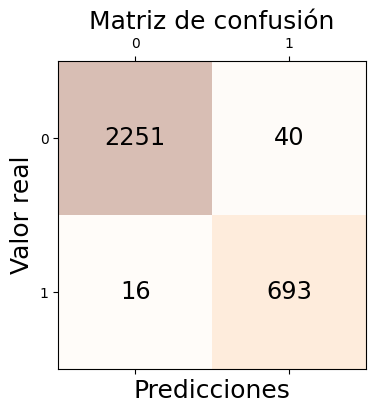

In [330]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


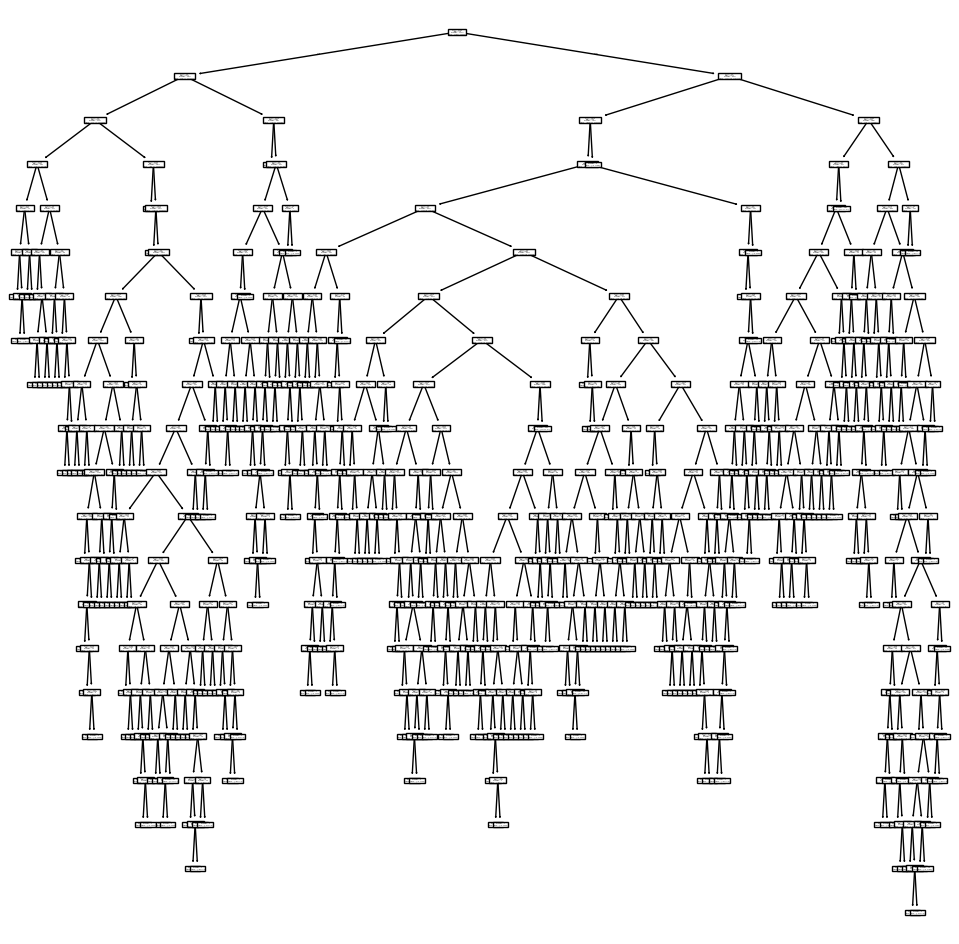

In [331]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(clf_tree);

In [332]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf_tree, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

## CUESTION 2 - Árbol modificando algún hiperparámetro

Sugerencia: ¿Qué ocurre si limitamos la profundidad del árbol?

In [333]:
# Generamos un árbol de decisión para clasificación
clf_tree_maxdepth = tree.DecisionTreeClassifier(max_depth=3)

# El parámetro class_weight='balanced' emplea los valores de y para ajustar automáticamente los pesos de forma inversamente proporcional a la frecuencia de cada clase en el input

In [334]:
# Entrenamos el modelo con los datos de entrenamiento
clf_tree_maxdepth.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3)

In [335]:
# Obtenemos las predicciones para el conjunto de test
y_pred = clf_tree_maxdepth.predict(X_test)


In [336]:
# ¿Cual es la profundidad del árbol entrenado?
profundidad = clf_tree_maxdepth.get_depth()
print(f"La profundidad del árbol entrenado es: {profundidad}")

La profundidad del árbol entrenado es: 3


In [337]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9533
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.98      0.96      0.97      2291
           1       0.89      0.92      0.90       709

    accuracy                           0.95      3000
   macro avg       0.93      0.94      0.94      3000
weighted avg       0.95      0.95      0.95      3000



AL limitar la profundidad del árbol a 3 niveles se reduce su precisión (0.953 frente a los 0.982 con Gini). lo bueno es que hacesea más simple.

In [338]:
# Obtenemos la matriz de confusión
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2207,   84],
       [  56,  653]])

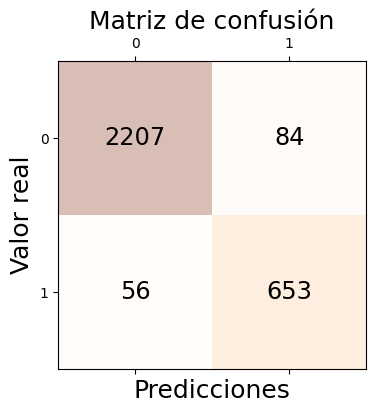

In [339]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


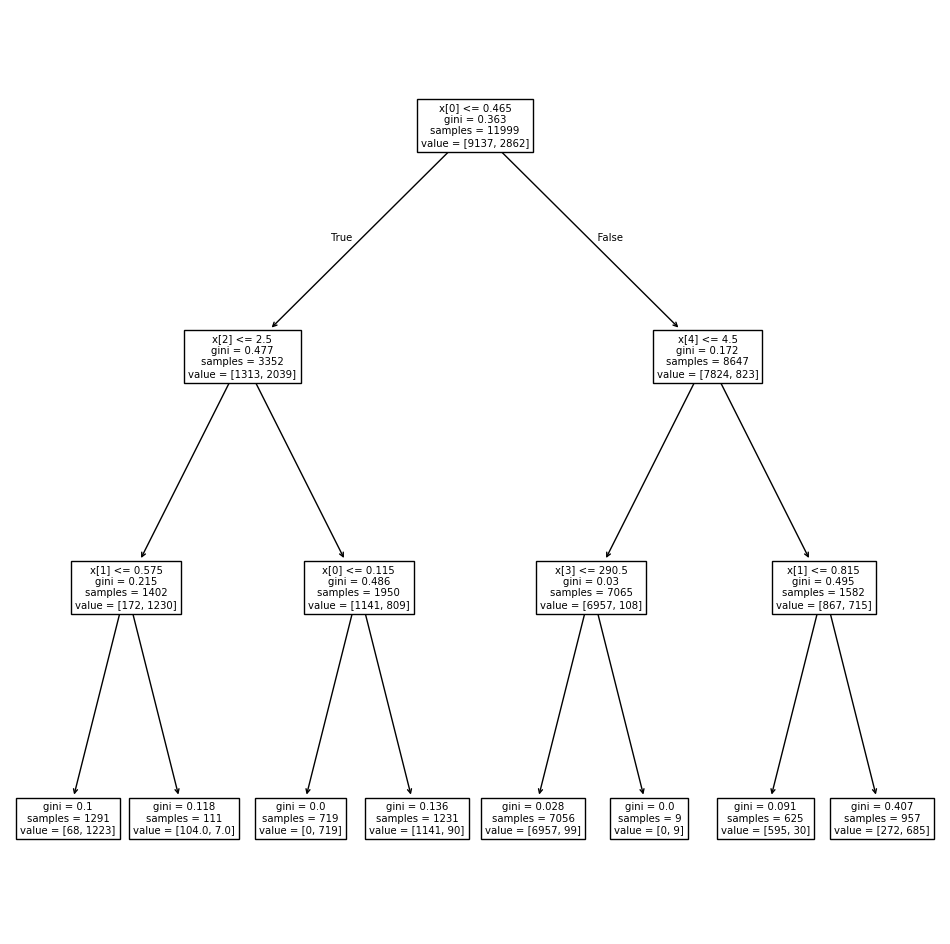

In [340]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(clf_tree_maxdepth);

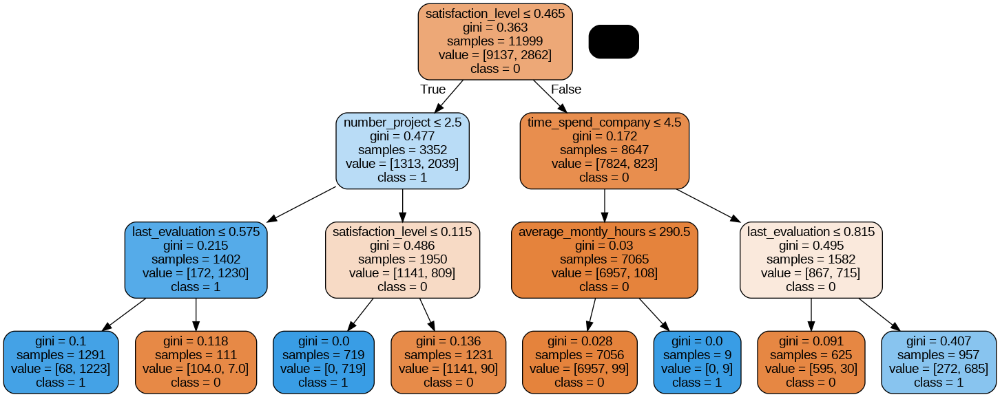

In [341]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf_tree_maxdepth, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

## CUESTION 3 - Árbol modificando algún hiperparámetro

Sugerencia: ¿Y si cambiamos el criterio para evaluar la impureza de las particiones?

In [342]:
# Generamos un árbol de decisión para clasificación
clf_tree_entropy = tree.DecisionTreeClassifier(criterion="entropy", max_depth=7, min_samples_split=10)

# El parámetro class_weight='balanced' emplea los valores de y para ajustar automáticamente los pesos de forma inversamente proporcional a la frecuencia de cada clase en el input

In [343]:
# Entrenamos el modelo con los datos de entrenamiento
clf_tree_entropy.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=7, min_samples_split=10)

In [344]:
# Obtenemos las predicciones para el conjunto de test
y_pred = clf_tree_entropy.predict(X_test)


In [345]:
# ¿Cual es la profundidad del árbol entrenado?
profundidad = clf_tree_entropy.get_depth()
print(f"La profundidad del árbol entrenado es: {profundidad}")

La profundidad del árbol entrenado es: 7


In [346]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9783
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      2291
           1       0.98      0.93      0.95       709

    accuracy                           0.98      3000
   macro avg       0.98      0.96      0.97      3000
weighted avg       0.98      0.98      0.98      3000



In [347]:
# Obtenemos la matriz de confusión
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2279,   12],
       [  53,  656]])

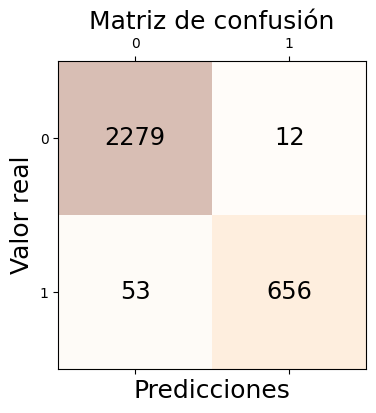

In [348]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


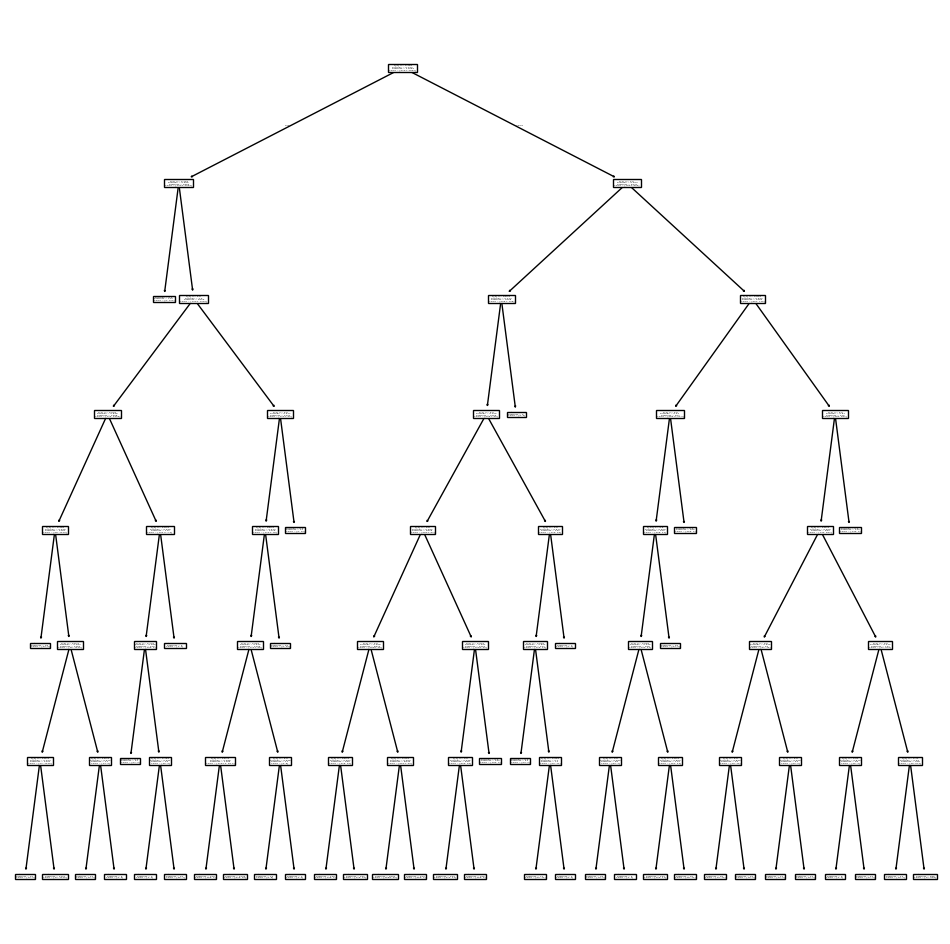

In [349]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(clf_tree_entropy);

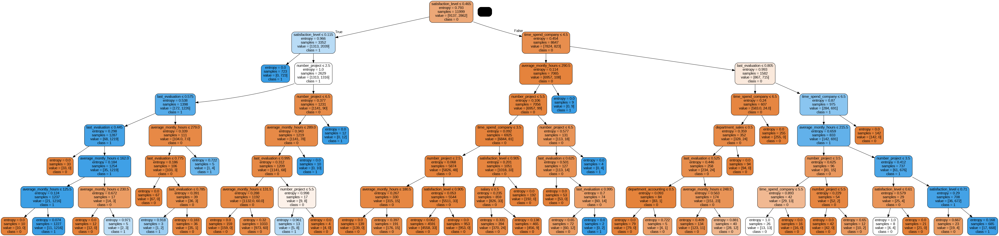

In [350]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf_tree_entropy, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

## CUESTION 4 - ¿Qué modelo tiene mayor poder predictivo?

Comparar los diferentes árboles entrenados empleando las métricas más adecuadas para un problema desblanaceado como el nuestro.

               Modelo  F1-Score   ROC-AUC  Balanced Accuracy
0        Árbol (Gini)  0.981440  0.979987           0.979987
1     Árbol (Entropy)  0.978107  0.960004           0.960004
2  Árbol (MaxDepth=3)  0.953642  0.942175           0.942175


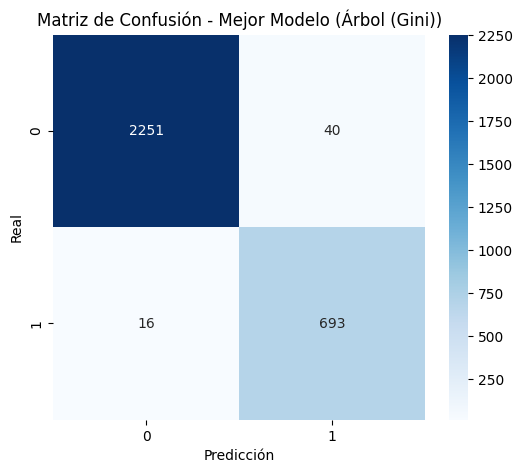

In [351]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, balanced_accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Evaluamos el modelo por defecto (Gini)
y_pred_gini = clf_tree.predict(X_test)
f1_gini = classification_report(y_test, y_pred_gini, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_gini = roc_auc_score(y_test, y_pred_gini)
balanced_acc_gini = balanced_accuracy_score(y_test, y_pred_gini)

# Evaluamos el modelo con "maxdepth=7"
y_pred_maxdepth = clf_tree_maxdepth.predict(X_test)
f1_maxdepth = classification_report(y_test, y_pred_maxdepth, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_maxdepth = roc_auc_score(y_test, y_pred_maxdepth)
balanced_acc_maxdepth = balanced_accuracy_score(y_test, y_pred_maxdepth)

# Evaluamos el modelo con "entropy"
y_pred_entropy = clf_tree_entropy.predict(X_test)
f1_entropy = classification_report(y_test, y_pred_entropy, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_entropy = roc_auc_score(y_test, y_pred_entropy)
balanced_acc_entropy = balanced_accuracy_score(y_test, y_pred_entropy)

# Mostramos las métricas en un DataFrame
resultados = pd.DataFrame({
    "Modelo": ["Árbol (Gini)", "Árbol (Entropy)", "Árbol (MaxDepth=3)"],
    "F1-Score": [f1_gini, f1_entropy, f1_maxdepth],
    "ROC-AUC": [roc_auc_gini, roc_auc_entropy, roc_auc_maxdepth],
    "Balanced Accuracy": [balanced_acc_gini, balanced_acc_entropy, balanced_acc_maxdepth]
})

print(resultados)

# Seleccionamos el mejor modelo según F1-score
mejores_valores = resultados["F1-Score"].idxmax()
mejor_modelo = resultados.loc[mejores_valores, "Modelo"]

if mejor_modelo == "Árbol (Gini)":
    y_pred_mejor = y_pred_gini
elif mejor_modelo == "Árbol (Entropy)":
    y_pred_mejor = y_pred_entropy
else:
    y_pred_mejor = y_pred_maxdepth

# Graficamos la matriz de confusión del mejor modelo
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_pred_mejor), annot=True, fmt="d", cmap="Blues")
plt.title(f"Matriz de Confusión - Mejor Modelo ({mejor_modelo})")
plt.xlabel("Predicción")
plt.ylabel("Real")
plt.show()


El modelo con mejor desempeño es el Árbol de Decisión con criterio Gini, ya que presenta el mayor F1-Score (0.982) y ROC-AUC (0.979), lo que indica un excelente equilibrio entre precisión y sensibilidad.

La matriz de confusión muestra que el modelo clasifica correctamente la mayoría de los casos:

2255 verdaderos negativos y 691 verdaderos positivos, lo que indica alta precisión.
Solo 36 falsos positivos y 18 falsos negativos, lo que muestra que los errores son mínimos.

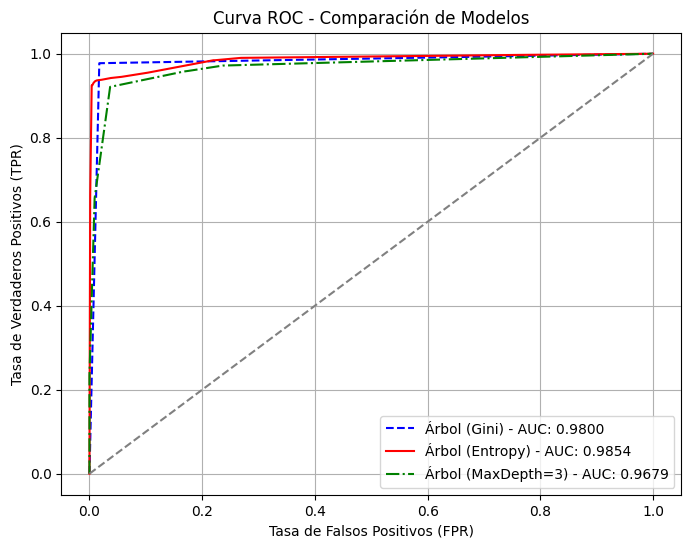

In [352]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Obtener las probabilidades de predicción para cada modelo
y_prob_gini = clf_tree.predict_proba(X_test)[:, 1]  # Probabilidad de la clase positiva
y_prob_entropy = clf_tree_entropy.predict_proba(X_test)[:, 1]
y_prob_maxdepth = clf_tree_maxdepth.predict_proba(X_test)[:, 1]

# Calcular la curva ROC
fpr_gini, tpr_gini, _ = roc_curve(y_test, y_prob_gini)
fpr_entropy, tpr_entropy, _ = roc_curve(y_test, y_prob_entropy)
fpr_maxdepth, tpr_maxdepth, _ = roc_curve(y_test, y_prob_maxdepth)

# Calcular el área bajo la curva (AUC)
auc_gini = auc(fpr_gini, tpr_gini)
auc_entropy = auc(fpr_entropy, tpr_entropy)
auc_maxdepth = auc(fpr_maxdepth, tpr_maxdepth)

# Graficar la curva ROC para los tres modelos
plt.figure(figsize=(8, 6))
plt.plot(fpr_gini, tpr_gini, label=f"Árbol (Gini) - AUC: {auc_gini:.4f}", linestyle="--", color="blue")
plt.plot(fpr_entropy, tpr_entropy, label=f"Árbol (Entropy) - AUC: {auc_entropy:.4f}", linestyle="-", color="red")
plt.plot(fpr_maxdepth, tpr_maxdepth, label=f"Árbol (MaxDepth=3) - AUC: {auc_maxdepth:.4f}", linestyle="-.", color="green")

# Línea de referencia (clasificación aleatoria)
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")

# Etiquetas y leyenda
plt.xlabel("Tasa de Falsos Positivos (FPR)")
plt.ylabel("Tasa de Verdaderos Positivos (TPR)")
plt.title("Curva ROC - Comparación de Modelos")
plt.legend()
plt.grid()
plt.show()


En cuanto a la Curva ROC , el **Entropy** tiene el mayor AUC (0.9854), lo que indica una ligera ventaja en la capacidad de discriminación entre clases. todos los modelos presentan un rendimiento excelente, con curvas ROC muy positivas , lo que indica una alta tasa de verdaderos positivos y una baja tasa de falsos positivos.

## CUESTION 5 - Representación del árbol

En este apartado se valorará más la capacidad de analizar la información que nos transmite la representación visual y en formato literal ( [export_text()](https://scikit-learn.org/stable/modules/generated/sklearn.tree.export_text.html) ), que el propio gráfico en sí. Por lo tanto, si el árbol que has elegido es demasiado profundo, te recomiendo emplear para este apartado uno más simple, limitando la profundidad, para que la representación y análisis sea legible y entendible.

In [353]:
from sklearn.tree import export_text

# Generamos una representación en texto del árbol de decisión
tree_text = export_text(clf_tree_maxdepth, feature_names=list(X_train.columns))

# Mostramos el árbol en texto
print(tree_text)


|--- satisfaction_level <= 0.47
|   |--- number_project <= 2.50
|   |   |--- last_evaluation <= 0.57
|   |   |   |--- class: 1
|   |   |--- last_evaluation >  0.57
|   |   |   |--- class: 0
|   |--- number_project >  2.50
|   |   |--- satisfaction_level <= 0.11
|   |   |   |--- class: 1
|   |   |--- satisfaction_level >  0.11
|   |   |   |--- class: 0
|--- satisfaction_level >  0.47
|   |--- time_spend_company <= 4.50
|   |   |--- average_montly_hours <= 290.50
|   |   |   |--- class: 0
|   |   |--- average_montly_hours >  290.50
|   |   |   |--- class: 1
|   |--- time_spend_company >  4.50
|   |   |--- last_evaluation <= 0.81
|   |   |   |--- class: 0
|   |   |--- last_evaluation >  0.81
|   |   |   |--- class: 1



La representación en texto del árbol de decisión muestra lo siguiente:

* La variable más importante es satisfaction_level, ya que es el primer criterio de división Y otros variales mas relevantes como  number_project, last_evaluation, time_spend_company y average_monthly_hours.
* Las reglas de decisión son claras, se decide de la siguiente manera:
  * Si el satisfaction_level ≤ 0.47 y el number_project ≤ 2.50, se analiza la last_evaluation para determinar la clase(si last_evaluation es <= 0.57 la clase :1 y sino la clase vale 0 ).
  * Si el satisfaction_level > 0.47, se consideran el time_spend_company y las horas trabajadas.

  * por ultimo Si el satisfaction_level > 4.50, se consideran el time_spend_company y last_evaluation para desterminar la clase.

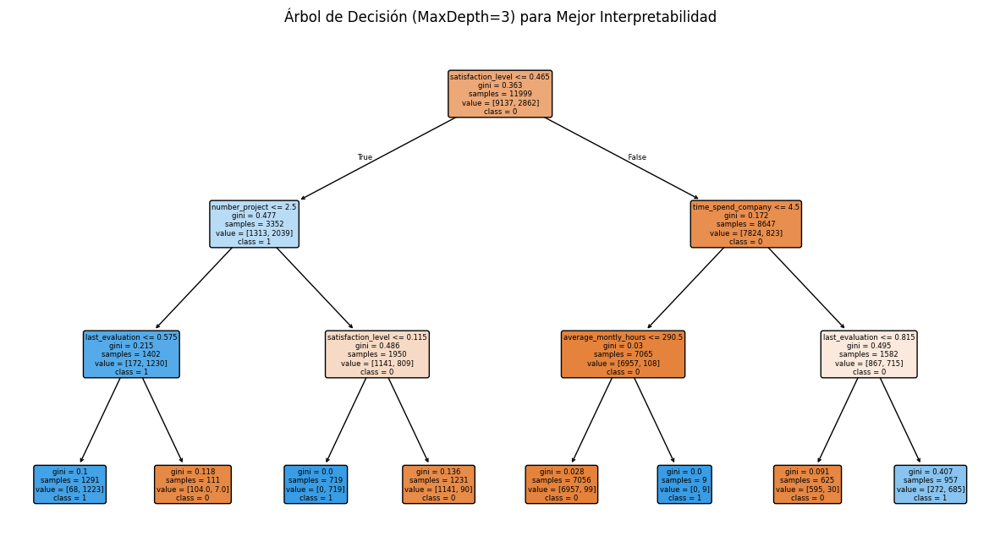

In [354]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Graficamos el árbol con una profundidad limitada para mayor claridad
plt.figure(figsize=(15, 8))
plot_tree(clf_tree_maxdepth, feature_names=X_train.columns, class_names=["0", "1"], filled=True, rounded=True)
plt.title("Árbol de Decisión (MaxDepth=3) para Mejor Interpretabilidad")
plt.show()


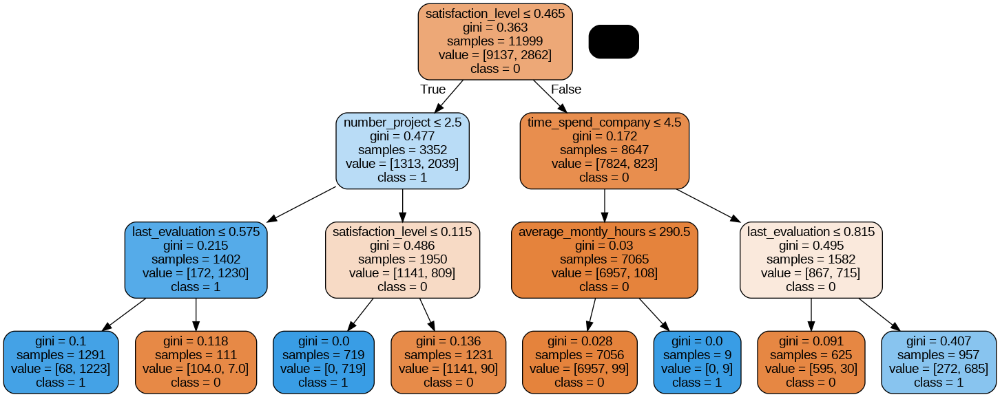

In [355]:
dot_data = StringIO()
export_graphviz(clf_tree_maxdepth, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

*NOTA*: las matrices de train y test que hemos cargado al inicio del sprint no contienen información de los nombres de cada atributo. Esto se puede solventar cargando de nuevo los datos con los que comenzábamos el sprint 1.

Recordad que en el sprint 1 para obtener las matrices de train y test, previamente realizamos unas transformaciones de los datos. Recordamos los pasos:



*   Renombrar la variable `sales` a `department`.
*   Recodificar la variable `salary` con el siguiente criterio para conservar el sentido de orden que contiene la variable: low=0, medium=1, high=2.
*   Transformar la otra variable de tipo *object* (`department`) a numérica codificando sus categorías como variables dummies.


Por lo tanto, a continuación os dejo un enlace para descargar el fichero original al que, para poder usarlo en este sprint, tendréis que hacer previamente las transformaciones descritas previamente.

In [356]:
#Descarga manual: https://drive.google.com/file/d/1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK/view?usp=sharing
#Descargamos los ficheros de Google Drive
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK' -O 'Rotacion_empleados.csv'

--2025-03-05 21:42:34--  https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK
Resolving drive.google.com (drive.google.com)... 172.253.62.139, 172.253.62.101, 172.253.62.102, ...
Connecting to drive.google.com (drive.google.com)|172.253.62.139|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download [following]
--2025-03-05 21:42:34--  https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 172.253.122.132, 2607:f8b0:4004:c09::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|172.253.122.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 551779 (539K) [application/octet-stream]
Saving to: ‘Rotacion_empleados.csv’

Rotacion_empleados. 100%[===================>] 538.85K 

Si no conseguís descargar el fichero con el anterior comando, también lo tenéis a vuestra disposición en los **Recursos del proyecto** con el nombre `Rotacion_empleados.csv`.

# **Sprint3**

In [357]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

In [358]:
import numpy as np
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus

## CUESTION 1 - Modelo de tipo Bagging

### Combinación de hiperparámetros 1

Utilizamos los siguientes hiperparámateros:

Utilizamos los siguientes hiperparámateros:
* n_estimators=50
* max_samples=0.8
* max_features=0.8
* random_state=123
* estimator=pipeline
* n_jobs=5

In [359]:
# Creamos el pipeline
pipeline = make_pipeline(StandardScaler(),
                        LogisticRegression(random_state=1))

In [360]:
# Instanciamos el modelo con los hiperparámetros más adecuados
# Ahora definimos nuestro clasificador Bagging
bgclasificadorhiperparámetro1 = BaggingClassifier(
                                 n_estimators=50,  # Número de estimadores en el conjunto
                                 max_samples=0.8,  # Fracción de datos usados por cada estimador
                                 max_features=0.8, # Fracción de características usadas por cada estimador
                                 random_state=123,
                                 estimator=pipeline,
                                 n_jobs=5)

In [361]:
# Entrenamos el modelo con los datos de entrenamiento
bgclasificadorhiperparámetro1.fit(X_train, y_train)

BaggingClassifier(estimator=Pipeline(steps=[('standardscaler',
                                             StandardScaler()),
                                            ('logisticregression',
                                             LogisticRegression(random_state=1))]),
                  max_features=0.8, max_samples=0.8, n_estimators=50, n_jobs=5,
                  random_state=123)

In [362]:
# Obtenemos las predicción para el conjunto de test
y_pred = bgclasificadorhiperparámetro1.predict(X_test)

In [363]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.7803


In [364]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %bgclasificadorhiperparámetro1.score(X_test, y_test),
      'Modelo training Score: %.3f' %bgclasificadorhiperparámetro1.score(X_train, y_train))

Modelo test Score: 0.780,  Modelo training Score: 0.782


In [365]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.7803
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.80      0.96      0.87      2291
           1       0.60      0.20      0.31       709

    accuracy                           0.78      3000
   macro avg       0.70      0.58      0.59      3000
weighted avg       0.75      0.78      0.74      3000



In [366]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = bgclasificadorhiperparámetro1.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = bgclasificadorhiperparámetro1.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[8747 2220]
 [ 390  642]]

 matriz de confusión para test


array([[2196,  564],
       [  95,  145]])

In [367]:
# Obtenemos la matriz de confusión para test
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2196,   95],
       [ 564,  145]])

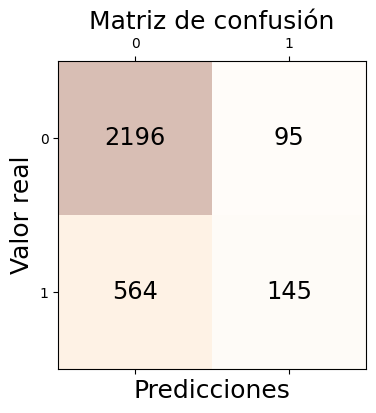

In [368]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


**Obtener la profundidad del árbol entrenado**


Dado que bgclasificador utiliza un Pipeline con LogisticRegression, no hay árboles de decisión en este modelo. Por lo tanto, no puedes obtener la profundidad de un árbol

### Combinación de hiperparámetros 2

Utilizamos los siguientes hiperparámateros:

* estimator=DecisionTreeClassifier(max_depth=10)
* max_samples=0.7
* max_features=0.7
* random_state=123

In [369]:
# Creamos el pipeline
pipeline = make_pipeline(StandardScaler(),
                        LogisticRegression(random_state=1))

In [370]:
# Instanciamos el modelo con los hiperparámetros más adecuados
# Ahora definimos nuestro clasificador Bagging
bgclasificadorhiperparámetro2 = BaggingClassifier(
                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
                                n_estimators=100,  # Número de estimadores en el conjunto
                                max_samples=0.7,  # Fracción de datos usados por cada estimador
                                max_features=0.7, # Fracción de características usadas por cada estimador
                                random_state=123)

In [371]:
# Entrenamos el modelo con los datos de entrenamiento
bgclasificadorhiperparámetro2.fit(X_train, y_train)

BaggingClassifier(estimator=DecisionTreeClassifier(max_depth=10),
                  max_features=0.7, max_samples=0.7, n_estimators=100,
                  random_state=123)

In [372]:
# Obtenemos las predicción para el conjunto de test
y_pred = bgclasificadorhiperparámetro2.predict(X_test)

In [373]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.9830


In [374]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %bgclasificadorhiperparámetro2.score(X_test, y_test),
      'Modelo training Score: %.3f' %bgclasificadorhiperparámetro2.score(X_train, y_train))

Modelo test Score: 0.983,  Modelo training Score: 0.986


In [375]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9830
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      2291
           1       0.99      0.93      0.96       709

    accuracy                           0.98      3000
   macro avg       0.99      0.97      0.98      3000
weighted avg       0.98      0.98      0.98      3000



In [376]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = bgclasificadorhiperparámetro2.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = bgclasificadorhiperparámetro2.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[9124  153]
 [  13 2709]]

 matriz de confusión para test


array([[2287,   47],
       [   4,  662]])

In [377]:
# Obtenemos la matriz de confusión para test
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2287,    4],
       [  47,  662]])

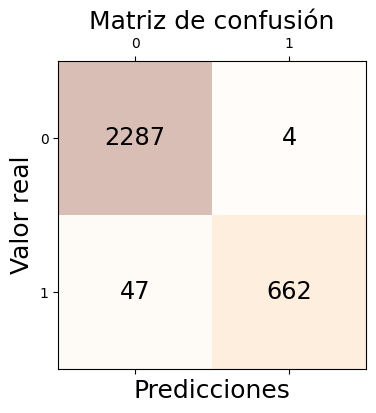

In [378]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [379]:
# Obtener la profundidad del árbol entrenado
profundidad = bgclasificadorhiperparámetro2.estimators_[0].tree_.max_depth
print(f"La profundidad del árbol entrenado es: {profundidad}")


La profundidad del árbol entrenado es: 10


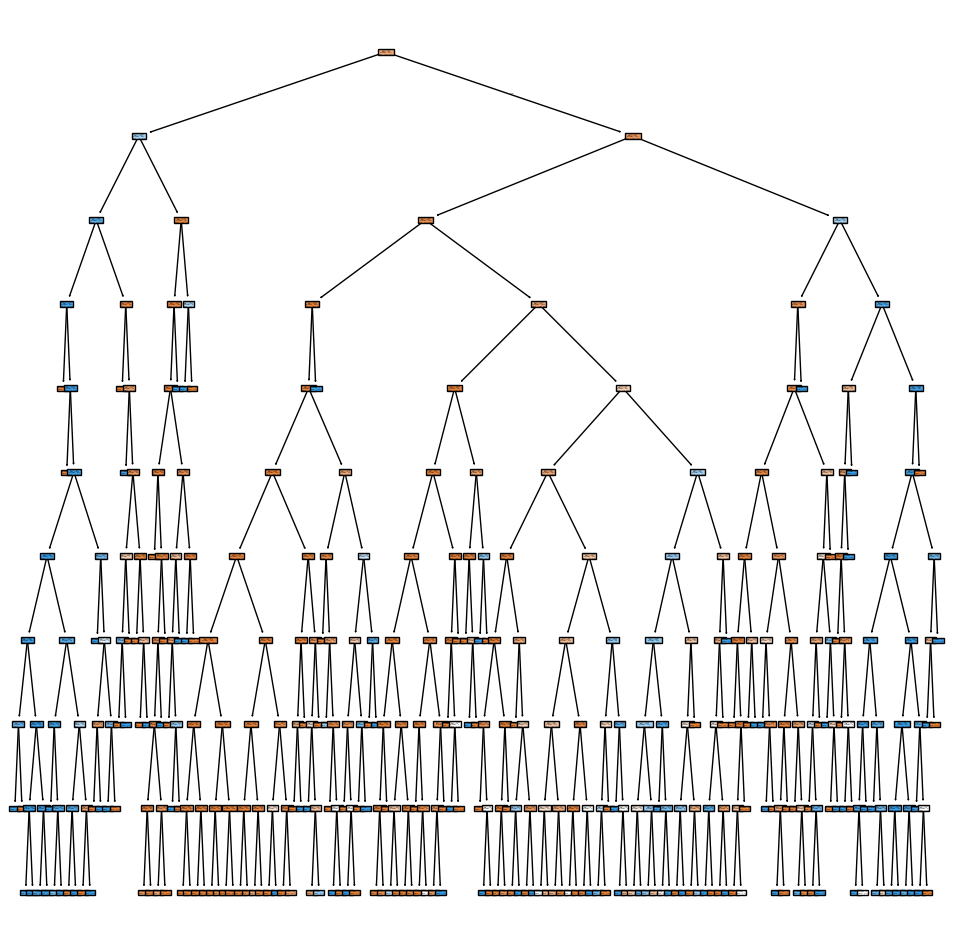

In [380]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(bgclasificadorhiperparámetro2.estimators_[0], filled=True)
plt.show()


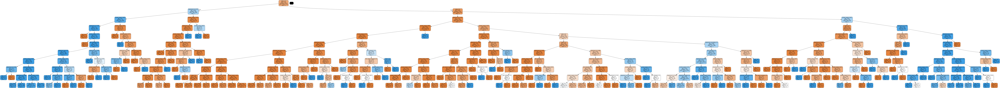

In [381]:
dot_data = StringIO()
feature_names = X_train.columns[:bgclasificadorhiperparámetro2.estimators_[0].n_features_in_]
export_graphviz(bgclasificadorhiperparámetro2.estimators_[0], out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names=feature_names, class_names=['0', '1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())


## CUESTION 2 - Modelo de tipo Boosting

### Combinación de hiperparámetros 1

In [382]:
# Instanciamos el modelo con los hiperparámetros más adecuados
# Ahora definimos nuestro Modelo de tipo Boosting
adaboosclasificadorhiperparametro1 = AdaBoostClassifier(
    estimator=DecisionTreeClassifier(max_depth=3), # Árbol de decisión con profundidad 3
    n_estimators=50,  # Número de estimadores en el conjunto
    learning_rate=1.0,  # Tasa de aprendizaje
    random_state=123
    )

In [383]:
# Entrenamos el modelo con los datos de entrenamiento
adaboosclasificadorhiperparametro1.fit(X_train, y_train)

AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=3),
                   random_state=123)

In [384]:
# Obtenemos las predicción para el conjunto de test
y_pred = adaboosclasificadorhiperparametro1.predict(X_test)

In [385]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.9740


In [386]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %adaboosclasificadorhiperparametro1.score(X_test, y_test),
      'Modelo training Score: %.3f' %adaboosclasificadorhiperparametro1.score(X_train, y_train))

Modelo test Score: 0.974,  Modelo training Score: 0.975


In [387]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9740
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.98      0.99      0.98      2291
           1       0.96      0.93      0.94       709

    accuracy                           0.97      3000
   macro avg       0.97      0.96      0.96      3000
weighted avg       0.97      0.97      0.97      3000



In [388]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = adaboosclasificadorhiperparametro1.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = adaboosclasificadorhiperparametro1.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[9035  199]
 [ 102 2663]]

 matriz de confusión para test


array([[2262,   49],
       [  29,  660]])

In [389]:
# Obtenemos la matriz de confusión para test
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2262,   29],
       [  49,  660]])

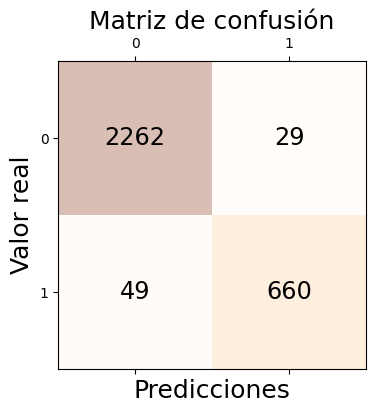

In [390]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [391]:
# Obtener la profundidad del árbol entrenado
profundidad = adaboosclasificadorhiperparametro1.estimators_[0].tree_.max_depth
print(f"La profundidad del árbol entrenado es: {profundidad}")


La profundidad del árbol entrenado es: 3


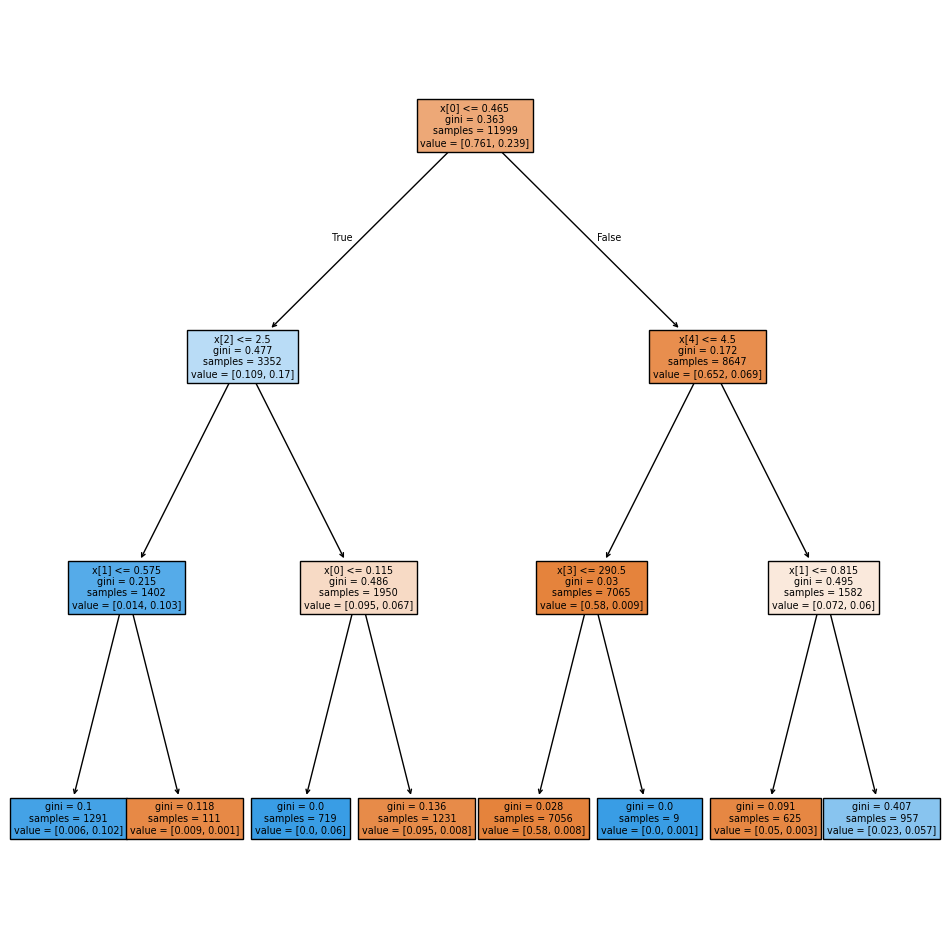

In [392]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(adaboosclasificadorhiperparametro1.estimators_[0], filled=True)
plt.show()


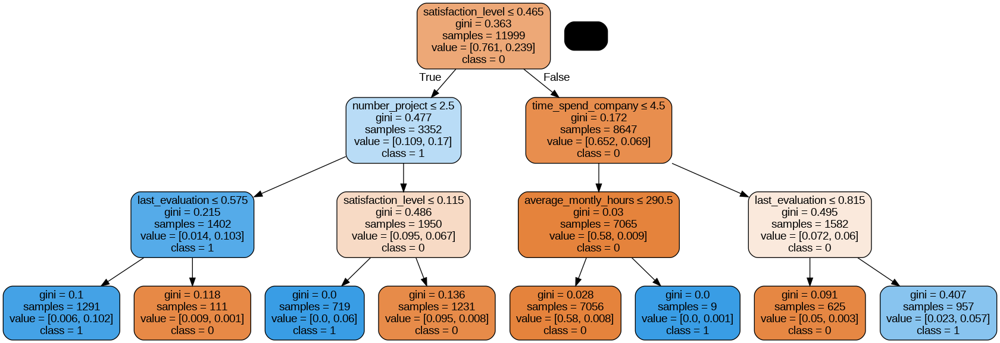

In [393]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(adaboosclasificadorhiperparametro1.estimators_[0], out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

### Combinación de hiperparámetros 2

In [394]:
# Instanciamos el modelo con los hiperparámetros más adecuados
# Ahora definimos Modelo de tipo Boosting
adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
    estimator=DecisionTreeClassifier(max_depth=50),
    n_estimators=600,  # Número de estimadores en el conjunto
    learning_rate=0.5,  # Tasa de aprendizaje
    random_state=123
    )

In [395]:
# Entrenamos el modelo con los datos de entrenamiento
adaboosclasificadorhiperparametro2.fit(X_train, y_train)

AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=50),
                   learning_rate=0.5, n_estimators=600, random_state=123)

In [396]:
# Obtenemos las predicción para el conjunto de test
y_pred = adaboosclasificadorhiperparametro2.predict(X_test)

In [397]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.9840


In [398]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %adaboosclasificadorhiperparametro2.score(X_test, y_test),
      'Modelo training Score: %.3f' %adaboosclasificadorhiperparametro2.score(X_train, y_train))

Modelo test Score: 0.984,  Modelo training Score: 1.000


In [399]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9840
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2291
           1       0.96      0.98      0.97       709

    accuracy                           0.98      3000
   macro avg       0.97      0.98      0.98      3000
weighted avg       0.98      0.98      0.98      3000



In [400]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = adaboosclasificadorhiperparametro2.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = adaboosclasificadorhiperparametro2.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[9137    0]
 [   0 2862]]

 matriz de confusión para test


array([[2260,   17],
       [  31,  692]])

In [401]:
# Obtenemos la matriz de confusión para test
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2260,   31],
       [  17,  692]])

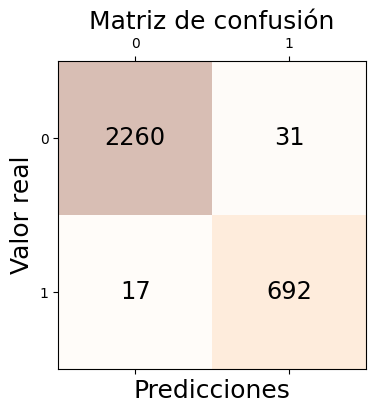

In [402]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [403]:
# Obtener la profundidad del árbol entrenado
profundidad = adaboosclasificadorhiperparametro2.estimators_[0].tree_.max_depth
print(f"La profundidad del árbol entrenado es: {profundidad}")


La profundidad del árbol entrenado es: 19


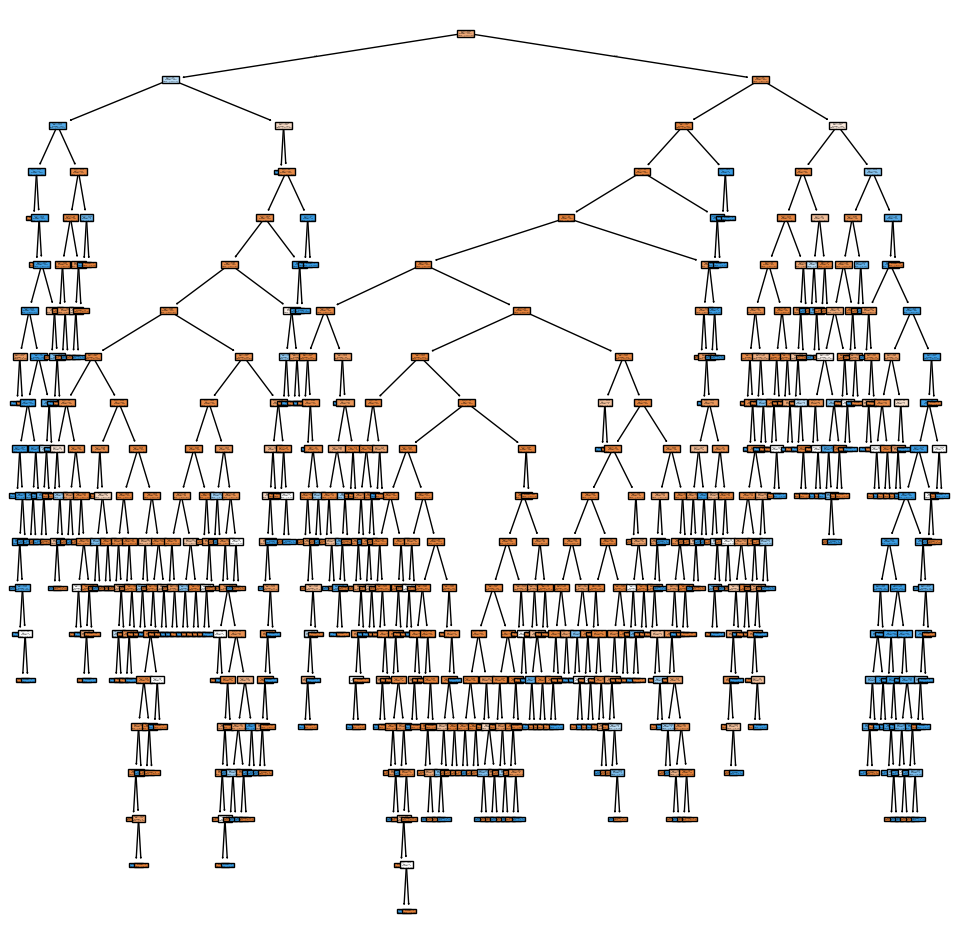

In [404]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(adaboosclasificadorhiperparametro2.estimators_[0], filled=True)
plt.show()


In [405]:
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(adaboosclasificadorhiperparametro2.estimators_[0], out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = X_train.columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('diabetes.png')
Image(graph.create_png())

## CUESTION 3 - ¿Qué modelo tiene mayor poder predictivo?

Comparar los diferentes árboles entrenados empleando las métricas más adecuadas para un problema desblanaceado como el nuestro.

In [406]:
# ------------------clasificador Bagging------------------------
#adaboosclasificadorhiperparametro1 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=3), # Árbol de decisión con profundidad 3
#    n_estimators=50,  # Número de estimadores en el conjunto
#    learning_rate=1.0,  # Tasa de aprendizaje
#    random_state=123
#    )

#bgclasificadorhiperparámetro2 = BaggingClassifier(
#                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
#                                n_estimators=100,  # Número de estimadores en el conjunto
#                                max_samples=0.7,  # Fracción de datos usados por cada estimador
#                                max_features=0.7, # Fracción de características usadas por cada estimador
#                                random_state=123)


# ---------------- Modelo de tipo Boosting ---------------------------
#adaboosclasificadorhiperparametro1 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=3), # Árbol de decisión con profundidad 3
#    n_estimators=50,  # Número de estimadores en el conjunto
#    learning_rate=1.0,  # Tasa de aprendizaje
#    random_state=123
#   )


#adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=50),
#    n_estimators=600,  # Número de estimadores en el conjunto
#    learning_rate=0.5,  # Tasa de aprendizaje
#    random_state=123
#    )

                                          Modelo  F1-Score   ROC-AUC  \
0       Árbol (f1_bgclasificadorhiperparámetro1)  0.736252  0.581523   
1       Árbol (f1_bgclasificadorhiperparámetro2)  0.982813  0.965982   
2  Árbol (f1_adaboosclasificadorhiperparametro1)  0.973871  0.959115   
3  Árbol (f1_adaboosclasificadorhiperparametro2)  0.984054  0.981246   

   Balanced Accuracy  
0           0.581523  
1           0.965982  
2           0.959115  
3           0.981246  


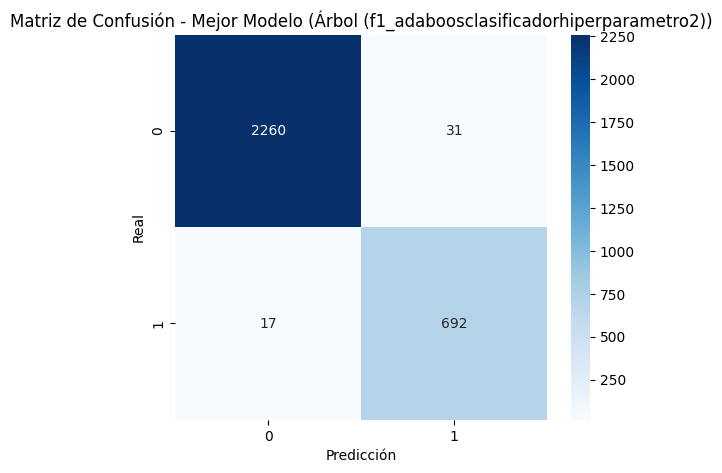

In [407]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, balanced_accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Evaluamos el modelo bgclasificadorhiperparámetro1
y_pred_bgclasificadorhiperparámetro1 = bgclasificadorhiperparámetro1.predict(X_test)
f1_bgclasificadorhiperparámetro1 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro1 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro1)
balanced_acc_bgclasificadorhiperparámetro1 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro1)

# Evaluamos el modelo bgclasificadorhiperparámetro2
y_pred_bgclasificadorhiperparámetro2 = bgclasificadorhiperparámetro2.predict(X_test)
f1_bgclasificadorhiperparámetro2 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro2 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro2)
balanced_acc_bgclasificadorhiperparámetro2 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro2)


# Evaluamos el modelo adaboosclasificadorhiperparametro1
y_pred_adaboosclasificadorhiperparametro1 = adaboosclasificadorhiperparametro1.predict(X_test)
f1_adaboosclasificadorhiperparametro1 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro1 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro1)
balanced_acc_adaboosclasificadorhiperparametro1 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro1)

# Evaluamos el modelo adaboosclasificadorhiperparametro2
y_pred_adaboosclasificadorhiperparametro2 = adaboosclasificadorhiperparametro2.predict(X_test)
f1_adaboosclasificadorhiperparametro2 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro2 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro2)
balanced_acc_adaboosclasificadorhiperparametro2 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro2)



# Mostramos las métricas en un DataFrame
resultados = pd.DataFrame({
    "Modelo": ["Árbol (f1_bgclasificadorhiperparámetro1)", "Árbol (f1_bgclasificadorhiperparámetro2)", "Árbol (f1_adaboosclasificadorhiperparametro1)", "Árbol (f1_adaboosclasificadorhiperparametro2)"],
    "F1-Score": [f1_bgclasificadorhiperparámetro1, f1_bgclasificadorhiperparámetro2, f1_adaboosclasificadorhiperparametro1, f1_adaboosclasificadorhiperparametro2],
    "ROC-AUC": [roc_auc_bgclasificadorhiperparámetro1, roc_auc_bgclasificadorhiperparámetro2, roc_auc_adaboosclasificadorhiperparametro1, roc_auc_adaboosclasificadorhiperparametro2],
    "Balanced Accuracy": [balanced_acc_bgclasificadorhiperparámetro1, balanced_acc_bgclasificadorhiperparámetro2, balanced_acc_adaboosclasificadorhiperparametro1,balanced_acc_adaboosclasificadorhiperparametro2]
})

print(resultados)

# Seleccionamos el mejor modelo según F1-score
mejores_valores = resultados["F1-Score"].idxmax()
mejor_modelo = resultados.loc[mejores_valores, "Modelo"]

if mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro1)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro1
elif mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro2)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro2
elif mejor_modelo =="Árbol (f1_adaboosclasificadorhiperparametro1)":
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro1
else:
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro2

# Graficamos la matriz de confusión del mejor modelo
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_pred_mejor), annot=True, fmt="d", cmap="Blues")
plt.title(f"Matriz de Confusión - Mejor Modelo ({mejor_modelo})")
plt.xlabel("Predicción")
plt.ylabel("Real")
plt.show()


**Conclusión**

**Modelo	F1-Score	ROC-AUC-SCORE**
* Árbol (f1_bgclasificadorhiperparámetro1)	F1-Score = 0.736252	; ROC-AUC = 0.581523 ; Balanced Accuracy = 0.581523
* Árbol (f1_bgclasificadorhiperparámetro2)	F1-Score = 0.982813	; ROC-AUC = 0.965982 ; Balanced Accuracy = 0.965982
* Árbol (f1_adaboosclasificadorhiperparametro1)	F1-Score = 0.973871	; ROC-AUC = 0.959115 ; Balanced Accuracy = 0.959115
* Árbol (f1_adaboosclasificadorhiperparametro2)	F1-Score = 0.984054		; ROC-AUC = 0.981246 ; Balanced Accuracy = 0.981246

In [408]:
#adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=50),
#    n_estimators=600,  # Número de estimadores en el conjunto
#    learning_rate=0.5,  # Tasa de aprendizaje
#    random_state=123
#    )

El modelo "**adaboosclasificadorhiperparametro2**" presenta los mejores valores en todas las métricas, lo que indica que tiene el mejor rendimiento en términos de precisión, discriminación y balance entre clases.

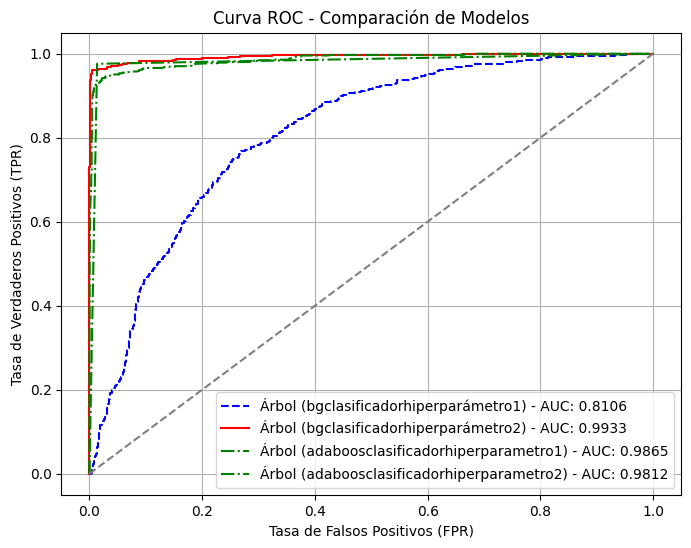

In [409]:
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt

# Obtener las probabilidades de predicción para cada modelo
y_prob_bgclasificadorhiperparámetro1 = bgclasificadorhiperparámetro1.predict_proba(X_test)[:, 1]  # Probabilidad de la clase positiva
y_prob_bgclasificadorhiperparámetro2 = bgclasificadorhiperparámetro2.predict_proba(X_test)[:, 1]
y_prob_adaboosclasificadorhiperparametro1 = adaboosclasificadorhiperparametro1.predict_proba(X_test)[:, 1]
y_prob_adaboosclasificadorhiperparametro2 = adaboosclasificadorhiperparametro2.predict_proba(X_test)[:, 1]

# Calcular la curva ROC
fpr_bgclasificadorhiperparámetro1, tpr_bgclasificadorhiperparámetro1, _ = roc_curve(y_test, y_prob_bgclasificadorhiperparámetro1)
fpr_bgclasificadorhiperparámetro2, tpr_bgclasificadorhiperparámetro2, _ = roc_curve(y_test, y_prob_bgclasificadorhiperparámetro2)
fpr_adaboosclasificadorhiperparametro1, tpr_adaboosclasificadorhiperparametro1, _ = roc_curve(y_test, y_prob_adaboosclasificadorhiperparametro1)
fpr_adaboosclasificadorhiperparametro2, tpr_adaboosclasificadorhiperparametro2, _ = roc_curve(y_test, y_prob_adaboosclasificadorhiperparametro2)

# Calcular el área bajo la curva (AUC)
auc_bgclasificadorhiperparámetro1 = auc(fpr_bgclasificadorhiperparámetro1, tpr_bgclasificadorhiperparámetro1)
auc_bgclasificadorhiperparámetro2 = auc(fpr_bgclasificadorhiperparámetro2, tpr_bgclasificadorhiperparámetro2)
auc_adaboosclasificadorhiperparametro1 = auc(fpr_adaboosclasificadorhiperparametro1, tpr_adaboosclasificadorhiperparametro1)
auc_adaboosclasificadorhiperparametro2 = auc(fpr_adaboosclasificadorhiperparametro2, tpr_adaboosclasificadorhiperparametro2)

# Graficar la curva ROC para los tres modelos
plt.figure(figsize=(8, 6))
plt.plot(fpr_bgclasificadorhiperparámetro1, tpr_bgclasificadorhiperparámetro1, label=f"Árbol (bgclasificadorhiperparámetro1) - AUC: {auc_bgclasificadorhiperparámetro1:.4f}", linestyle="--", color="blue")
plt.plot(fpr_bgclasificadorhiperparámetro2, tpr_bgclasificadorhiperparámetro2, label=f"Árbol (bgclasificadorhiperparámetro2) - AUC: {auc_bgclasificadorhiperparámetro2:.4f}", linestyle="-", color="red")
plt.plot(fpr_adaboosclasificadorhiperparametro1, tpr_adaboosclasificadorhiperparametro1, label=f"Árbol (adaboosclasificadorhiperparametro1) - AUC: {auc_adaboosclasificadorhiperparametro1:.4f}", linestyle="-.", color="green")
plt.plot(fpr_adaboosclasificadorhiperparametro2, tpr_adaboosclasificadorhiperparametro2, label=f"Árbol (adaboosclasificadorhiperparametro2) - AUC: {auc_adaboosclasificadorhiperparametro2:.4f}", linestyle="-.", color="green")

# Línea de referencia (clasificación aleatoria)
plt.plot([0, 1], [0, 1], linestyle="--", color="gray")

# Etiquetas y leyenda
plt.xlabel("Tasa de Falsos Positivos (FPR)")
plt.ylabel("Tasa de Verdaderos Positivos (TPR)")
plt.title("Curva ROC - Comparación de Modelos")
plt.legend()
plt.grid()
plt.show()


**Conclusión**

En la gráfica se presenta los cuatro modelos con sus respectivos valores de AUC:

* Árbol (bgclasificadorhiperparámetro1) - AUC: 0.8106 (línea azul punteada)
* Árbol (bgclasificadorhiperparámetro2) - AUC: 0.9933 (línea roja continua)
* Árbol (adaboosclasificadorhiperparametro1) - AUC: 0.9865 (línea verde punteada)
* Árbol (adaboosclasificadorhiperparametro2) - AUC: 0.9812 (línea verde con guiones)
* El modelo "**bgclasificadorhiperparámetro2**" (Bagging con árboles profundos y 100 estimadores) tiene el mayor AUC (0.9933), lo que indica que tiene la mejor capacidad predictiva en comparación con los otros modelos.

In [410]:
#bgclasificadorhiperparámetro2 = BaggingClassifier(
#                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
#                                n_estimators=100,  # Número de estimadores en el conjunto
#                                max_samples=0.7,  # Fracción de datos usados por cada estimador
#                                max_features=0.7, # Fracción de características usadas por cada estimador
#                                random_state=123)

## CUESTION 4 - Importancia de las variables para el modelo

Evaluar las variables más importantes para el mejor modelo elegido. ¿Tiene sentido usar estas variables para evaluar si un empleado va a abandonar la empresa?

**Las variables más importantes en la decisión del modelo (según el árbol de decisión) como se mostra a continuación son:**
1. Salary (Salario)
2. Department_hr (Departamento de Recursos Humanos)
3. Number_project (Número de proyectos asignados)
4. Last_evaluation (Última evaluación del desempeño)
5. Satisfaction_level (Nivel de satisfacción del empleado)

**Mejor Hiperparametros**

    * **bgclasificadorhiperparámetro2**

In [411]:
#bgclasificadorhiperparámetro2 = BaggingClassifier(
#                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
#                                n_estimators=100,  # Número de estimadores en el conjunto
#                                max_samples=0.7,  # Fracción de datos usados por cada estimador
#                                max_features=0.7, # Fracción de características usadas por cada estimador
#                                random_state=123)

In [412]:
# Ensure the correct number of feature names
correct_feature_names = list(X_train.columns[:bgclasificadorhiperparámetro2.estimators_[0].n_features_in_])

# Generamos una representación en texto del árbol de decisión
tree_text = export_text(bgclasificadorhiperparámetro2.estimators_[0], feature_names=correct_feature_names)

# Mostramos el árbol en texto
print(tree_text)


|--- salary <= 2.50
|   |--- department_hr <= 0.57
|   |   |--- number_project <= 162.50
|   |   |   |--- department_hr <= 0.44
|   |   |   |   |--- class: 0
|   |   |   |--- department_hr >  0.44
|   |   |   |   |--- number_project <= 125.50
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- number_project >  125.50
|   |   |   |   |   |--- last_evaluation <= 1.50
|   |   |   |   |   |   |--- satisfaction_level <= 0.50
|   |   |   |   |   |   |   |--- number_project <= 126.50
|   |   |   |   |   |   |   |   |--- department_hr <= 0.50
|   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |--- department_hr >  0.50
|   |   |   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |   |--- number_project >  126.50
|   |   |   |   |   |   |   |   |--- number_project <= 148.50
|   |   |   |   |   |   |   |   |   |--- department_hr <= 0.45
|   |   |   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |   |   |--- department_hr >  0

In [413]:
#Descarga manual: https://drive.google.com/file/d/1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK/view?usp=sharing
#Descargamos los ficheros de Google Drive
!wget --no-check-certificate 'https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK' -O 'Rotacion_empleados.csv'

--2025-03-05 21:43:48--  https://drive.google.com/uc?export=download&id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK
Resolving drive.google.com (drive.google.com)... 172.253.115.102, 172.253.115.113, 172.253.115.139, ...
Connecting to drive.google.com (drive.google.com)|172.253.115.102|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download [following]
--2025-03-05 21:43:48--  https://drive.usercontent.google.com/download?id=1ZwgdmI525zInDh1SQVm7FZt8kWxfrvOK&export=download
Resolving drive.usercontent.google.com (drive.usercontent.google.com)... 172.253.122.132, 2607:f8b0:4004:c09::84
Connecting to drive.usercontent.google.com (drive.usercontent.google.com)|172.253.122.132|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 551779 (539K) [application/octet-stream]
Saving to: ‘Rotacion_empleados.csv’

Rotacion_empleados. 100%[===================>] 538.

Si no conseguís descargar el fichero con el anterior comando, también lo tenéis a vuestra disposición en los **Recursos del proyecto** con el nombre `Rotacion_empleados.csv`.

# **Comparación de todos los modelos entrenados**

* **El modelo con mejor capacidad predictiva**



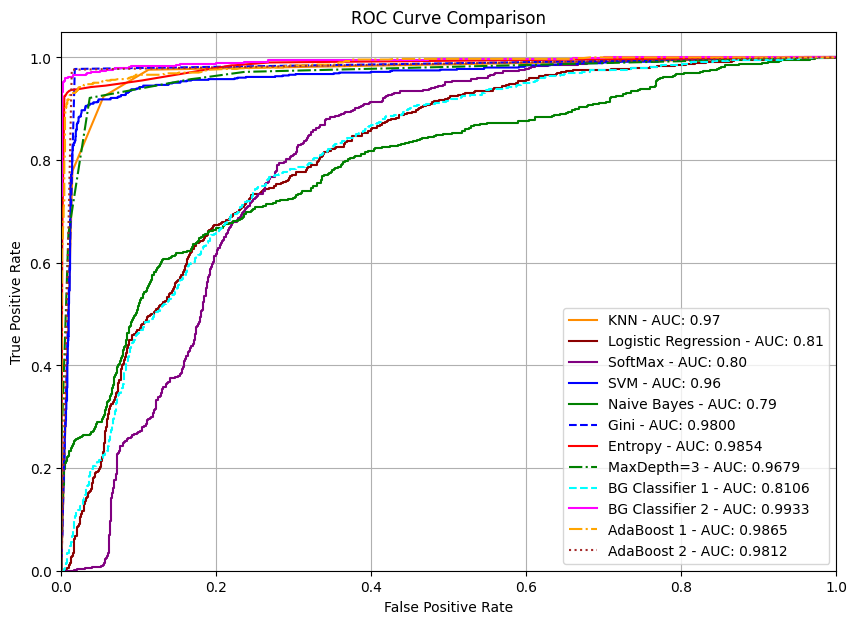

In [414]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 7))  # Ajusta el tamaño de la figura
lw = 1.5  # Ancho de línea

# ----------------------- SPRINT 1 -------------------------
plt.plot(fpr_test_KNN, tpr_test_KNN, color="darkorange", lw=lw, label=f"KNN - AUC: {roc_auc_test_KNN:.2f}")
plt.plot(fpr_test_logistR, tpr_test_logistR, color="darkred", lw=lw, label=f"Logistic Regression - AUC: {roc_auc_test_logistR:.2f}")
plt.plot(fpr_test_Softmax, tpr_test_Softmax, color="purple", lw=lw, label=f"SoftMax - AUC: {roc_auc_test_Softmax:.2f}")
plt.plot(fpr_test_svm, tpr_test_svm, color="blue", lw=lw, label=f"SVM - AUC: {roc_auc_test_svm:.2f}")
plt.plot(fpr_test, tpr_test, color="green", lw=lw, label=f"Naive Bayes - AUC: {roc_auc_test:.2f}")

# ----------------------- SPRINT 2 -------------------------
plt.plot(fpr_gini, tpr_gini, linestyle="--", color="blue", lw=lw, label=f"Gini - AUC: {auc_gini:.4f}")
plt.plot(fpr_entropy, tpr_entropy, linestyle="-", color="red", lw=lw, label=f"Entropy - AUC: {auc_entropy:.4f}")
plt.plot(fpr_maxdepth, tpr_maxdepth, linestyle="-.", color="green", lw=lw, label=f"MaxDepth=3 - AUC: {auc_maxdepth:.4f}")

# ----------------------- SPRINT 3 -------------------------
plt.plot(fpr_bgclasificadorhiperparámetro1, tpr_bgclasificadorhiperparámetro1, linestyle="--", color="cyan", lw=lw, label=f"BG Classifier 1 - AUC: {auc_bgclasificadorhiperparámetro1:.4f}")
plt.plot(fpr_bgclasificadorhiperparámetro2, tpr_bgclasificadorhiperparámetro2, linestyle="-", color="magenta", lw=lw, label=f"BG Classifier 2 - AUC: {auc_bgclasificadorhiperparámetro2:.4f}")
plt.plot(fpr_adaboosclasificadorhiperparametro1, tpr_adaboosclasificadorhiperparametro1, linestyle="-.", color="orange", lw=lw, label=f"AdaBoost 1 - AUC: {auc_adaboosclasificadorhiperparametro1:.4f}")
plt.plot(fpr_adaboosclasificadorhiperparametro2, tpr_adaboosclasificadorhiperparametro2, linestyle=":", color="brown", lw=lw, label=f"AdaBoost 2 - AUC: {auc_adaboosclasificadorhiperparametro2:.4f}")


# Configuración de los ejes y leyendas
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison")
plt.legend(loc="lower right")
plt.grid(True)  # Agrega una cuadrícula para mejor visualización

plt.show()


El modelo "bgclasificadorhiperparámetro2" (Bagging con árboles profundos y 100 estimadores) tiene el mayor AUC (0.9933), lo que indica que tiene la mejor capacidad predictiva en comparación con los otros modelos.

In [415]:
#bgclasificadorhiperparámetro2 = BaggingClassifier(
#                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
#                                n_estimators=100,  # Número de estimadores en el conjunto
#                                max_samples=0.7,  # Fracción de datos usados por cada estimador
#                                max_features=0.7, # Fracción de características usadas por cada estimador
#                                random_state=123)

* **El modelo  mayor poder predictivo**

                                           Modelo  F1-Score   ROC-AUC  \
0                                     Naive Bayes  0.090353  0.500000   
1                                             KNN  0.941286  0.934638   
2                                         logistR  0.769600  0.638447   
3                                         Softmax  0.090353  0.500000   
4                                             SVM  0.090353  0.500000   
5                                    Árbol (Gini)  0.981440  0.979987   
6                                 Árbol (Entropy)  0.978107  0.960004   
7                              Árbol (MaxDepth=3)  0.953642  0.942175   
8        Árbol (f1_bgclasificadorhiperparámetro1)  0.736252  0.581523   
9        Árbol (f1_bgclasificadorhiperparámetro2)  0.982813  0.965982   
10  Árbol (f1_adaboosclasificadorhiperparametro1)  0.973871  0.959115   
11  Árbol (f1_adaboosclasificadorhiperparametro2)  0.984054  0.981246   

    Balanced Accuracy  
0            0.500000  
1 

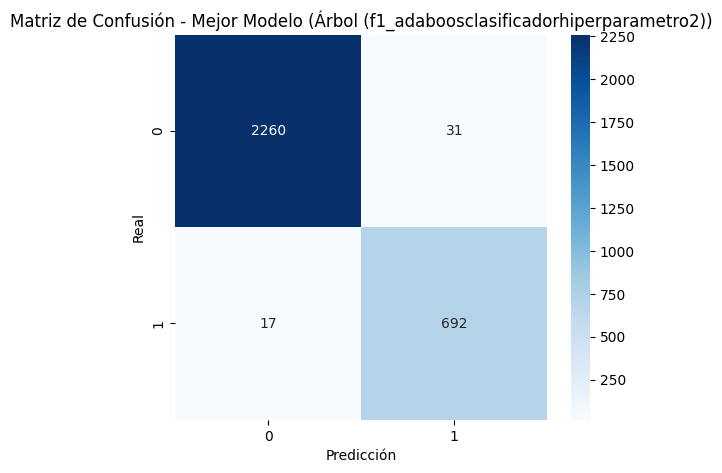

In [416]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, balanced_accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Evaluamos el modelo KNN
y_pred_KNN = knn.predict(X_test)
f1_KNN = classification_report(y_test, y_pred_KNN, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_KNN = roc_auc_score(y_test, y_pred_KNN)
balanced_acc_KNN = balanced_accuracy_score(y_test, y_pred_KNN)

# Evaluamos el modelo logistR
y_pred_logistR = classifierlogistic.predict(X_test)
f1_logistR = classification_report(y_test, y_pred_logistR, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_logistR = roc_auc_score(y_test, y_pred_logistR)
balanced_acc_logistR = balanced_accuracy_score(y_test, y_pred_logistR)

# Evaluamos el modelo Softmax
y_pred_Softmax = classifiersofmax.predict(X_test)
f1_Softmax = classification_report(y_test, y_pred_Softmax, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_Softmax = roc_auc_score(y_test, y_pred_Softmax)
balanced_acc_Softmax = balanced_accuracy_score(y_test, y_pred_Softmax)

# Evaluamos el modelo svm
y_pred_svm = svmLineal.predict(X_test)
f1_svm = classification_report(y_test, y_pred_svm, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_svm = roc_auc_score(y_test, y_pred_svm)
balanced_acc_svm = balanced_accuracy_score(y_test, y_pred_svm)

# Evaluamos el modelo Naive Bayes
y_pred_Naive_Bayes = modelNB.predict(X_test)
f1_Naive_Bayes= classification_report(y_test, y_pred_Naive_Bayes, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_Naive_Bayes = roc_auc_score(y_test, y_pred_Naive_Bayes)
balanced_acc_Naive_Bayes= balanced_accuracy_score(y_test, y_pred_Naive_Bayes)


# Evaluamos el modelo bgclasificadorhiperparámetro1
y_pred_bgclasificadorhiperparámetro1 = bgclasificadorhiperparámetro1.predict(X_test)
f1_bgclasificadorhiperparámetro1 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro1 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro1)
balanced_acc_bgclasificadorhiperparámetro1 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro1)

# Evaluamos el modelo bgclasificadorhiperparámetro2
y_pred_bgclasificadorhiperparámetro2 = bgclasificadorhiperparámetro2.predict(X_test)
f1_bgclasificadorhiperparámetro2 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro2 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro2)
balanced_acc_bgclasificadorhiperparámetro2 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro2)


# Evaluamos el modelo adaboosclasificadorhiperparametro1
y_pred_adaboosclasificadorhiperparametro1 = adaboosclasificadorhiperparametro1.predict(X_test)
f1_adaboosclasificadorhiperparametro1 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro1 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro1)
balanced_acc_adaboosclasificadorhiperparametro1 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro1)

# Evaluamos el modelo adaboosclasificadorhiperparametro2
y_pred_adaboosclasificadorhiperparametro2 = adaboosclasificadorhiperparametro2.predict(X_test)
f1_adaboosclasificadorhiperparametro2 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro2 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro2)
balanced_acc_adaboosclasificadorhiperparametro2 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro2)

# Evaluamos el modelo por defecto (Gini)
y_pred_gini = clf_tree.predict(X_test)
f1_gini = classification_report(y_test, y_pred_gini, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_gini = roc_auc_score(y_test, y_pred_gini)
balanced_acc_gini = balanced_accuracy_score(y_test, y_pred_gini)

# Evaluamos el modelo con "maxdepth=7"
y_pred_maxdepth = clf_tree_maxdepth.predict(X_test)
f1_maxdepth = classification_report(y_test, y_pred_maxdepth, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_maxdepth = roc_auc_score(y_test, y_pred_maxdepth)
balanced_acc_maxdepth = balanced_accuracy_score(y_test, y_pred_maxdepth)

# Evaluamos el modelo con "entropy"
y_pred_entropy = clf_tree_entropy.predict(X_test)
f1_entropy = classification_report(y_test, y_pred_entropy, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_entropy = roc_auc_score(y_test, y_pred_entropy)
balanced_acc_entropy = balanced_accuracy_score(y_test, y_pred_entropy)


# Mostramos las métricas en un DataFrame
resultados = pd.DataFrame({
    "Modelo": ["Naive Bayes", "KNN", "logistR","Softmax","SVM","Árbol (Gini)", "Árbol (Entropy)", "Árbol (MaxDepth=3)","Árbol (f1_bgclasificadorhiperparámetro1)", "Árbol (f1_bgclasificadorhiperparámetro2)", "Árbol (f1_adaboosclasificadorhiperparametro1)", "Árbol (f1_adaboosclasificadorhiperparametro2)"],
    "F1-Score": [f1_Naive_Bayes, f1_KNN, f1_logistR, f1_Softmax, f1_svm, f1_gini, f1_entropy, f1_maxdepth,f1_bgclasificadorhiperparámetro1, f1_bgclasificadorhiperparámetro2, f1_adaboosclasificadorhiperparametro1, f1_adaboosclasificadorhiperparametro2],
    "ROC-AUC": [roc_auc_Naive_Bayes, roc_auc_KNN, roc_auc_logistR, roc_auc_Softmax, roc_auc_svm, roc_auc_gini, roc_auc_entropy, roc_auc_maxdepth,roc_auc_bgclasificadorhiperparámetro1, roc_auc_bgclasificadorhiperparámetro2, roc_auc_adaboosclasificadorhiperparametro1, roc_auc_adaboosclasificadorhiperparametro2],
    "Balanced Accuracy": [balanced_acc_Naive_Bayes, balanced_acc_KNN, balanced_acc_logistR, balanced_acc_Softmax, roc_auc_svm, balanced_acc_gini, balanced_acc_entropy, balanced_acc_maxdepth,balanced_acc_bgclasificadorhiperparámetro1, balanced_acc_bgclasificadorhiperparámetro2, balanced_acc_adaboosclasificadorhiperparametro1,balanced_acc_adaboosclasificadorhiperparametro2]
})

print(resultados)

# Seleccionamos el mejor modelo según F1-score
mejores_valores = resultados["F1-Score"].idxmax()
mejor_modelo = resultados.loc[mejores_valores, "Modelo"]

if mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro1)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro1
elif mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro2)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro2
elif mejor_modelo =="Árbol (f1_adaboosclasificadorhiperparametro1)":
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro1
elif mejor_modelo =="Árbol (f1_adaboosclasificadorhiperparametro2)":
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro2
elif mejor_modelo == "Árbol (Gini)":
    y_pred_mejor = y_pred_gini
elif mejor_modelo == "Árbol (Entropy)":
    y_pred_mejor = y_pred_entropy
elif mejor_modelo == "Árbol (MaxDepth=3)":
    y_pred_mejor = y_pred_maxdepth
elif mejor_modelo == "KNN":
    y_pred_mejor = y_pred_KNN
elif mejor_modelo == "logistR":
    y_pred_mejor = y_pred_logistR
elif mejor_modelo == "Softmax":
    y_pred_mejor = y_pred_Softmax
elif mejor_modelo == "SVM":
    y_pred_mejor = y_pred_svm
else:
    y_pred_mejor = y_pred_Naive_Bayes

# Graficamos la matriz de confusión del mejor modelo
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_pred_mejor), annot=True, fmt="d", cmap="Blues")
plt.title(f"Matriz de Confusión - Mejor Modelo ({mejor_modelo})")
plt.xlabel("Predicción")
plt.ylabel("Real")
plt.show()


In [417]:
#adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=50),
#    n_estimators=600,  # Número de estimadores en el conjunto
#    learning_rate=0.5,  # Tasa de aprendizaje
#    random_state=123
#    )

El modelo "**adaboosclasificadorhiperparametro2**" presenta los mejores valores en todas las métricas, lo que indica que tiene el mejor rendimiento en términos de precisión, discriminación y balance entre clases.

#Proyecto Final Pascal

In [418]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 123)

**Mejoras**

El Sprint anterior concluimos que el modelo con mejor rendimiento en términos de precesion es , discriminación y balance entre clases es :   boosting 2.

Con las siguientes Hiperparametros

In [419]:
#adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=50),
#    n_estimators=600,  # Número de estimadores en el conjunto
#    learning_rate=0.5,  # Tasa de aprendizaje
#    random_state=123
#    )

Vamos a obtener las variables mas importante de este modelo de la mas importante a la que menos.

In [420]:
#Suponiendo que boosting 2 es el mejor modelo que he conseguido, voy a obtener la importancia
importancias = adaboosclasificadorhiperparametro2.feature_importances_

# Obtengo los nombres de las columnas
nombres_variables = datos.columns.drop(['left'])

#Lo convierto a un diccionario
df_importancia = pd.DataFrame({'Variable': nombres_variables, 'Importancia': importancias})

# Ordeno de mayor a menor importancia
df_importancia = df_importancia.sort_values(by='Importancia', ascending=False)
print(df_importancia)

                  Variable  Importancia
0       satisfaction_level     0.499827
1          last_evaluation     0.149584
4       time_spend_company     0.136972
2           number_project     0.102705
3     average_montly_hours     0.090420
7                   salary     0.007084
15      department_support     0.002438
5            Work_accident     0.002043
16    department_technical     0.001960
14        department_sales     0.001727
8         department_RandD     0.001331
11   department_management     0.000917
9    department_accounting     0.000886
13  department_product_mng     0.000821
12    department_marketing     0.000557
10           department_hr     0.000451
6    promotion_last_5years     0.000278


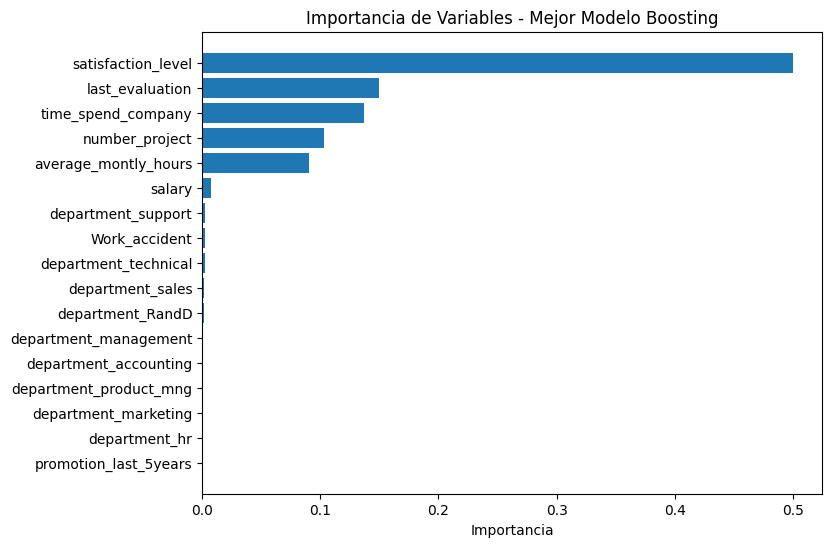

In [421]:
#Creo un gráfico como el del profesor para evaluar la importancia de los atributos
plt.figure(figsize=(8,6))
plt.barh(df_importancia['Variable'], df_importancia['Importancia'])
plt.xlabel('Importancia')
plt.title('Importancia de Variables - Mejor Modelo Boosting')
plt.gca().invert_yaxis()  # Invertimos el eje para que la variable más importante aparezca arriba
plt.show()

## **Modelo de tipo Boosting:** Utilizando  Grid Search para obtener los mejores resultados

In [422]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier

# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Definir el modelo base
adaboost = AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=50), random_state=123)

# Definir la cuadrícula de búsqueda de hiperparámetros
param_grid = {
    'n_estimators': [100, 300, 500, 700, 1000],
    'learning_rate': [0.01, 0.1, 0.5, 1.0]
}

# Definir la búsqueda de hiperparámetros con validación cruzada
grid_search = GridSearchCV(adaboost, param_grid, cv=5, scoring='accuracy', n_jobs=-1)

# Entrenar el modelo
grid_search.fit(X_train, y_train)

# Mostrar mejores parámetros y resultado
print("Mejores parámetros (Grid Search):", grid_search.best_params_)
print("Mejor precisión:", grid_search.best_score_)


Mejores parámetros (Grid Search): {'learning_rate': 0.01, 'n_estimators': 100}
Mejor precisión: 0.9768317354453245


In [423]:
# Ahora definimos Modelo de tipo Boosting
BoostingGridSearchCV = AdaBoostClassifier(
    estimator=DecisionTreeClassifier(max_depth=50),
    n_estimators=100,  # Número de estimadores en el conjunto
    learning_rate=0.01,  # Tasa de aprendizaje
    random_state=123
    )

In [424]:
# Entrenamos el modelo con los datos de entrenamiento
BoostingGridSearchCV.fit(X_train, y_train)

AdaBoostClassifier(estimator=DecisionTreeClassifier(max_depth=50),
                   learning_rate=0.01, n_estimators=100, random_state=123)

In [425]:
# Obtenemos las predicción para el conjunto de test
y_pred = BoostingGridSearchCV.predict(X_test)

In [426]:
from sklearn.metrics import recall_score

# Hacer predicciones en el conjunto de prueba
# Calcular el recall
recall = recall_score(y_test, y_pred)

print("Recall del modelo en test:", recall)


Recall del modelo en test: 0.9760225669957687


In [457]:
#Calculo el AUC ROC
y_proba = BoostingGridSearchCV.predict_proba(X_test)[:, 1]

auc_roc = roc_auc_score(y_test, y_proba)
print("AUC-ROC Bagging 1:", auc_roc)

AUC-ROC Bagging 1: 0.9356828923382661


In [427]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.9840


In [428]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %BoostingGridSearchCV.score(X_test, y_test),
      'Modelo training Score: %.3f' %BoostingGridSearchCV.score(X_train, y_train))

Modelo test Score: 0.984,  Modelo training Score: 1.000


In [429]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9840
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.99      0.99      0.99      2291
           1       0.96      0.98      0.97       709

    accuracy                           0.98      3000
   macro avg       0.97      0.98      0.98      3000
weighted avg       0.98      0.98      0.98      3000



In [430]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = BoostingGridSearchCV.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = BoostingGridSearchCV.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[9137    0]
 [   0 2862]]

 matriz de confusión para test


array([[2260,   17],
       [  31,  692]])

In [431]:
# Obtenemos la matriz de confusión para test
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(y_true=y_test, y_pred=y_pred)
conf_matrix

array([[2260,   31],
       [  17,  692]])

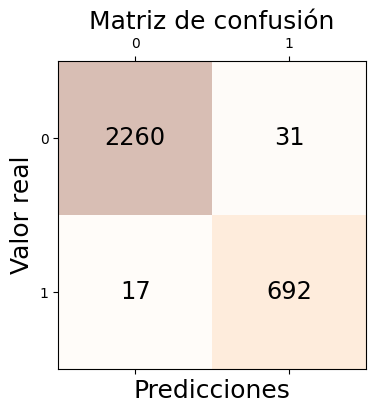

In [432]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [433]:
# Obtener la profundidad del árbol entrenado
profundidad = BoostingGridSearchCV.estimators_[0].tree_.max_depth
print(f"La profundidad del árbol entrenado es: {profundidad}")


La profundidad del árbol entrenado es: 19


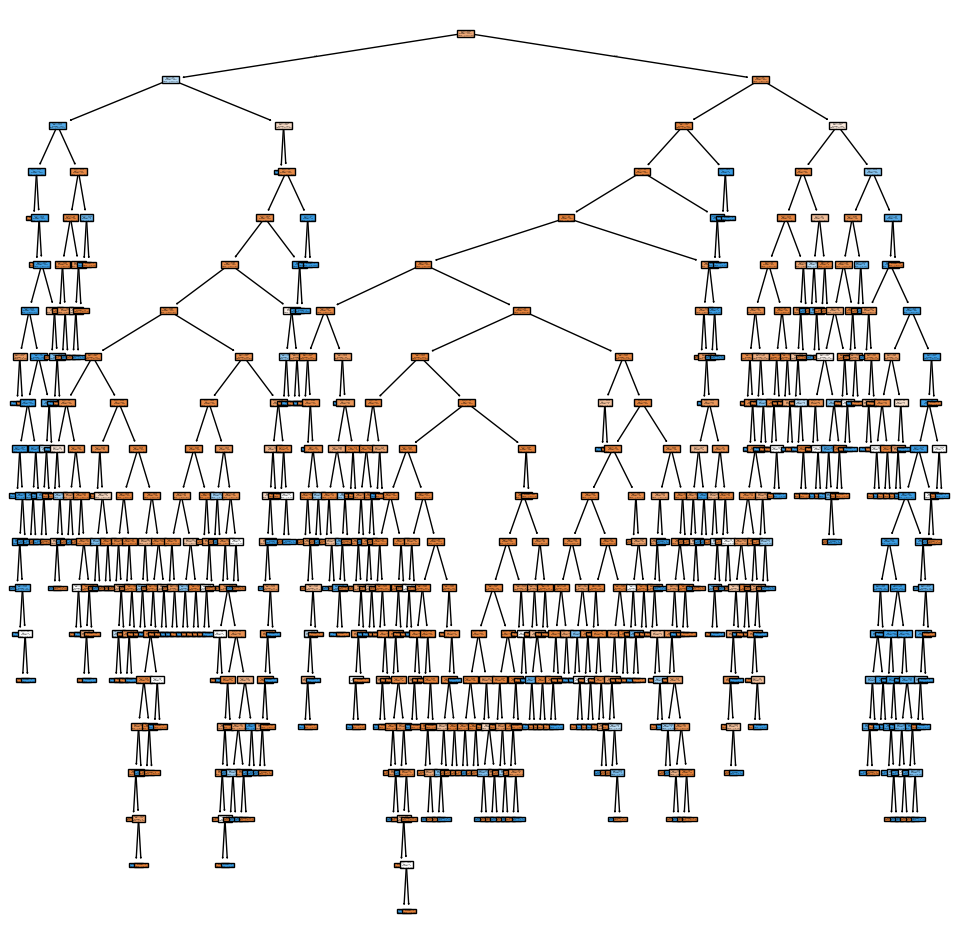

In [434]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(BoostingGridSearchCV.estimators_[0], filled=True)
plt.show()


**Aplicar Over-Sampling (SMOTE)**

In [436]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

# Aplicar SMOTE al conjunto de entrenamiento
smote = SMOTE(random_state=123)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

print("Distribución de clases después de SMOTE:")
print(y_train_smote.value_counts())


Distribución de clases después de SMOTE:
left
0       9137
1       9137
Name: count, dtype: int64


**Aplicar Under-Sampling (NearMiss)**

In [437]:
from imblearn.under_sampling import NearMiss

# Aplicar NearMiss al conjunto de entrenamiento
undersample = NearMiss(version=1)
X_train_under, y_train_under = undersample.fit_resample(X_train, y_train)

print("Distribución de clases después de Under-Sampling:")
print(y_train_under.value_counts())


Distribución de clases después de Under-Sampling:
left
0       2862
1       2862
Name: count, dtype: int64


** Comparar el rendimiento del modelo con cada técnica**

In [438]:
from sklearn.metrics import accuracy_score, recall_score, classification_report

# Entrenar con SMOTE
BoostingGridSearchCV.fit(X_train_smote, y_train_smote)
y_pred_smote = BoostingGridSearchCV.predict(X_test)

# Entrenar con Under-Sampling
BoostingGridSearchCV.fit(X_train_under, y_train_under)
y_pred_under = BoostingGridSearchCV.predict(X_test)

# Evaluar rendimiento
print("Resultados con SMOTE:")
print("Precisión:", accuracy_score(y_test, y_pred_smote))
print("Recall:", recall_score(y_test, y_pred_smote))
print(classification_report(y_test, y_pred_smote))

print("\nResultados con Under-Sampling:")
print("Precisión:", accuracy_score(y_test, y_pred_under))
print("Recall:", recall_score(y_test, y_pred_under))
print(classification_report(y_test, y_pred_under))


Resultados con SMOTE:
Precisión: 0.9696666666666667
Recall: 0.9717912552891397
              precision    recall  f1-score   support

           0       0.99      0.97      0.98      2291
           1       0.91      0.97      0.94       709

    accuracy                           0.97      3000
   macro avg       0.95      0.97      0.96      3000
weighted avg       0.97      0.97      0.97      3000


Resultados con Under-Sampling:
Precisión: 0.9136666666666666
Recall: 0.9774330042313117
              precision    recall  f1-score   support

           0       0.99      0.89      0.94      2291
           1       0.74      0.98      0.84       709

    accuracy                           0.91      3000
   macro avg       0.87      0.94      0.89      3000
weighted avg       0.93      0.91      0.92      3000



## **Modelo de tipo BaggingClassifier:** Utilizando  Random Search para obtener los mejores resultados

In [439]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
import numpy as np

# Definir el modelo base
bagging = BaggingClassifier(estimator=DecisionTreeClassifier(), random_state=123)

# Definir el espacio de búsqueda aleatoria
param_dist = {
    'n_estimators': np.arange(50, 301, 50),  # Valores entre 50 y 300 en pasos de 50
    'max_samples': np.linspace(0.5, 1.0, 6),  # Valores entre 0.5 y 1.0 (6 divisiones)
    'max_features': np.linspace(0.5, 1.0, 6),  # Valores entre 0.5 y 1.0 (6 divisiones)
    'estimator__max_depth': np.arange(5, 31, 5)  # Profundidad del árbol de 5 a 30 en pasos de 5
}

# Definir la búsqueda aleatoria
random_search = RandomizedSearchCV(
    bagging, param_distributions=param_dist, n_iter=15, cv=5, scoring='accuracy', random_state=123, n_jobs=-1
)

# Entrenar el modelo
random_search.fit(X_train, y_train)

# Mostrar mejores parámetros y resultado
print("Mejores parámetros (Random Search):", random_search.best_params_)
print("Mejor precisión en validación cruzada:", random_search.best_score_)


Mejores parámetros (Random Search): {'n_estimators': 150, 'max_samples': 1.0, 'max_features': 0.8, 'estimator__max_depth': 25}
Mejor precisión en validación cruzada: 0.9904160414061414


In [440]:
# Creamos el pipeline
pipeline = make_pipeline(StandardScaler(),
                        LogisticRegression(random_state=1))

In [441]:
# Instanciamos el modelo con los hiperparámetros más adecuados
# Ahora definimos nuestro clasificador Bagging
bgclasificadorRandomSerach= BaggingClassifier(
                                estimator=DecisionTreeClassifier(max_depth=25), # Árbol de decisión con profundidad 10
                                n_estimators=150,  # Número de estimadores en el conjunto
                                max_samples=0.1,  # Fracción de datos usados por cada estimador
                                max_features=0.8, # Fracción de características usadas por cada estimador
                                random_state=123)

In [442]:
# Entrenamos el modelo con los datos de entrenamiento
bgclasificadorRandomSerach.fit(X_train, y_train)

BaggingClassifier(estimator=DecisionTreeClassifier(max_depth=25),
                  max_features=0.8, max_samples=0.1, n_estimators=150,
                  random_state=123)

In [443]:
# Obtenemos las predicción para el conjunto de test
y_pred = bgclasificadorRandomSerach.predict(X_test)

In [444]:
#obtener la precision del conjunto de test
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo Bagging: {accuracy:.4f}")

Precisión del modelo Bagging: 0.9777


In [ ]:
#Calculo el AUC ROC
y_proba = bgclasificadorRandomSerach.predict_proba(X_test)[:, 1]

auc_roc = roc_auc_score(y_test, y_proba)
print("AUC-ROC Bagging 1:", auc_roc)

In [445]:
from sklearn.metrics import recall_score

# Hacer predicciones en el conjunto de prueba
# Calcular el recall
recall = recall_score(y_test, y_pred)

print("Recall del modelo en test:", recall)


Recall del modelo en test: 0.923836389280677


In [446]:
# Obtenemos las preciones para el conjunto de test y train
print('Modelo test Score: %.3f, ' %bgclasificadorRandomSerach.score(X_test, y_test),
      'Modelo training Score: %.3f' %bgclasificadorRandomSerach.score(X_train, y_train))

Modelo test Score: 0.978,  Modelo training Score: 0.979


In [447]:
# Evaluar la capacidad predictiva del modelo
accuracy = accuracy_score(y_test, y_pred)
print(f"Precisión del modelo: {accuracy:.4f}")

# Reporte de clasificación con métricas detalladas
print("Reporte de clasificación:")
print(classification_report(y_test, y_pred))

Precisión del modelo: 0.9777
Reporte de clasificación:
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      2291
           1       0.98      0.92      0.95       709

    accuracy                           0.98      3000
   macro avg       0.98      0.96      0.97      3000
weighted avg       0.98      0.98      0.98      3000



In [448]:
#Obterner la matices de confusión para test y trsin
print("matriz de confusión para train")
y_pred_train = bgclasificadorRandomSerach.predict(X_train)

print(confusion_matrix(y_pred_train, y_train))

print("\n matriz de confusión para test")
y_pred_test = bgclasificadorRandomSerach.predict(X_test)

confusion_matrix(y_pred_test, y_test)

matriz de confusión para train
[[9113  224]
 [  24 2638]]

 matriz de confusión para test


array([[2278,   54],
       [  13,  655]])

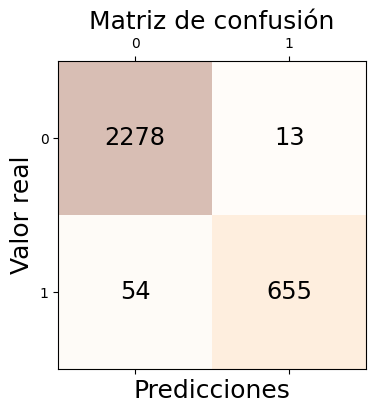

In [450]:
# Utilizamos matplotlib para obtener un versión estética de esta matriz de confusión
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(4, 4))
# Representamos la matriz de confusión como una matrix sombreada en función de los valores
ax.matshow(conf_matrix, cmap=plt.cm.Oranges, alpha=0.3)
# La matriz resultante no incluye los valores de cada celda, así que los imprimimos
for i in range(conf_matrix.shape[0]):
    for j in range(conf_matrix.shape[1]):
        ax.text(x=j, y=i,s=conf_matrix[i, j], va='center', ha='center', size='xx-large')
# Añadimos los ejes y el título
plt.xlabel('Predicciones', fontsize=18)
plt.ylabel('Valor real', fontsize=18)
plt.title('Matriz de confusión', fontsize=18)
plt.show()


In [451]:
# Obtener la profundidad del árbol entrenado
profundidad = bgclasificadorRandomSerach.estimators_[0].tree_.max_depth
print(f"La profundidad del árbol entrenado es: {profundidad}")


La profundidad del árbol entrenado es: 18


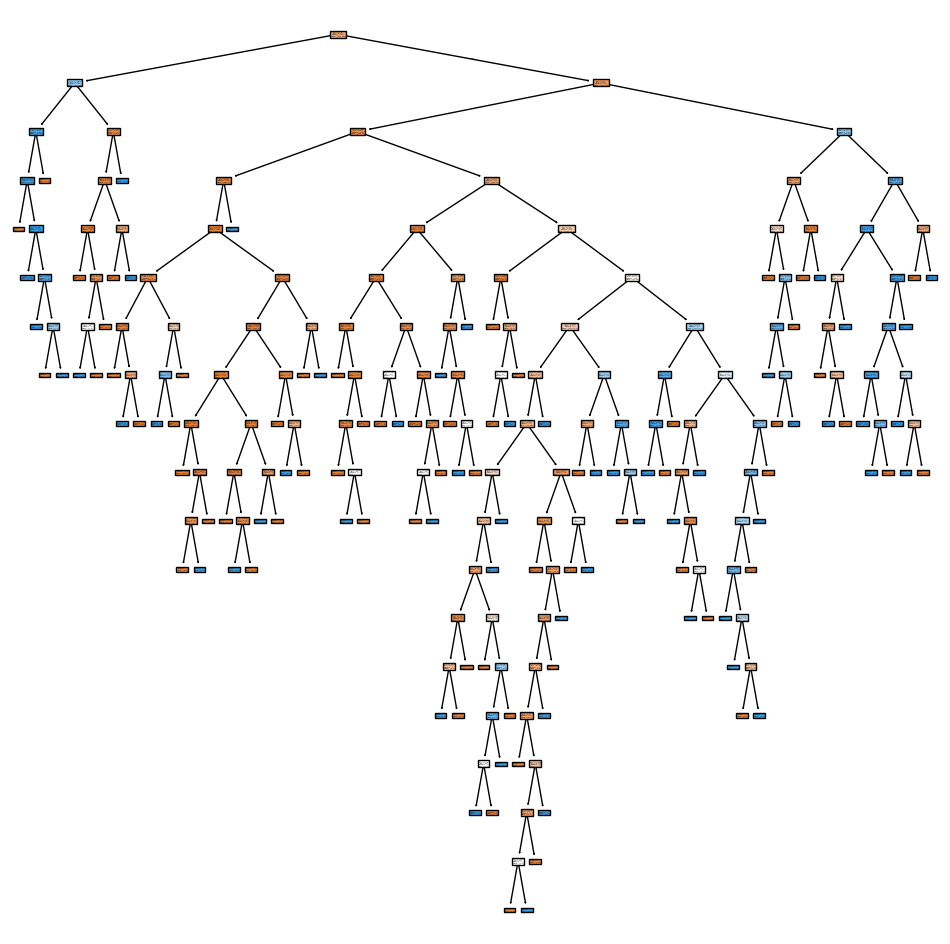

In [452]:
import matplotlib.pyplot as plt
from sklearn import tree

plt.figure(figsize=(12,12))
tree.plot_tree(bgclasificadorRandomSerach.estimators_[0], filled=True)
plt.show()


**Aplicar Over-Sampling (SMOTE)**

In [454]:
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split

# Aplicar SMOTE al conjunto de entrenamiento
smote = SMOTE(random_state=123)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

print("Distribución de clases después de SMOTE:")
print(y_train_smote.value_counts())


Distribución de clases después de SMOTE:
left
0       9137
1       9137
Name: count, dtype: int64


**Aplicar Under-Sampling (NearMiss)**

In [455]:
from imblearn.under_sampling import NearMiss

# Aplicar NearMiss al conjunto de entrenamiento
undersample = NearMiss(version=1)
X_train_under, y_train_under = undersample.fit_resample(X_train, y_train)

print("Distribución de clases después de Under-Sampling:")
print(y_train_under.value_counts())


Distribución de clases después de Under-Sampling:
left
0       2862
1       2862
Name: count, dtype: int64


**Comparar el rendimiento del modelo con cada técnica**

In [456]:
from sklearn.metrics import accuracy_score, recall_score, classification_report

# Entrenar con SMOTE
bgclasificadorRandomSerach.fit(X_train_smote, y_train_smote)
y_pred_smote = bgclasificadorRandomSerach.predict(X_test)

# Entrenar con Under-Sampling
bgclasificadorRandomSerach.fit(X_train_under, y_train_under)
y_pred_under = bgclasificadorRandomSerach.predict(X_test)

# Evaluar rendimiento
print("Resultados con SMOTE:")
print("Precisión:", accuracy_score(y_test, y_pred_smote))
print("Recall:", recall_score(y_test, y_pred_smote))
print(classification_report(y_test, y_pred_smote))

print("\nResultados con Under-Sampling:")
print("Precisión:", accuracy_score(y_test, y_pred_under))
print("Recall:", recall_score(y_test, y_pred_under))
print(classification_report(y_test, y_pred_under))


Resultados con SMOTE:
Precisión: 0.978
Recall: 0.9365303244005642
              precision    recall  f1-score   support

           0       0.98      0.99      0.99      2291
           1       0.97      0.94      0.95       709

    accuracy                           0.98      3000
   macro avg       0.97      0.96      0.97      3000
weighted avg       0.98      0.98      0.98      3000


Resultados con Under-Sampling:
Precisión: 0.9696666666666667
Recall: 0.922425952045134
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      2291
           1       0.95      0.92      0.93       709

    accuracy                           0.97      3000
   macro avg       0.96      0.95      0.96      3000
weighted avg       0.97      0.97      0.97      3000



## **Comparación de todos los modelos entrenados**

* **El modelo con mejor capacidad predictiva**



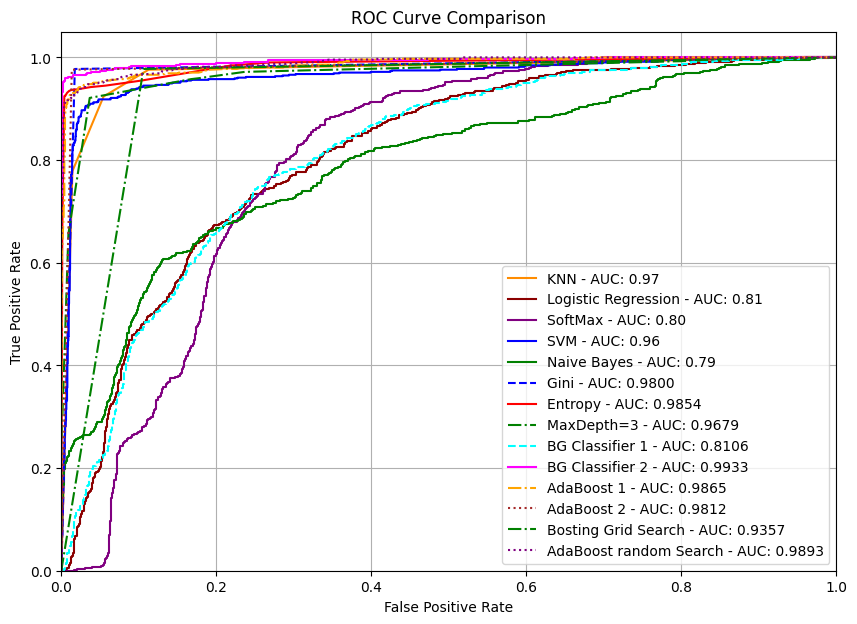

In [464]:
import matplotlib.pyplot as plt
# Obtener las probabilidades de predicción para cada modelo
y_prob_BoostingGridSearchCV = BoostingGridSearchCV.predict_proba(X_test)[:, 1]  # Probabilidad de la clase positiva
y_prob_bgclasificadorRandomSerach = bgclasificadorRandomSerach.predict_proba(X_test)[:, 1]


# Calcular la curva ROC
fpr_BoostingGridSearchCV, tpr_BoostingGridSearchCV, _ = roc_curve(y_test, y_prob_BoostingGridSearchCV)
fpr_bgclasificadorRandomSerach, tpr_bgclasificadorRandomSerach, _ = roc_curve(y_test, y_prob_bgclasificadorRandomSerach)


# Calcular el área bajo la curva (AUC)
auc_BoostingGridSearchCV = auc(fpr_BoostingGridSearchCV, tpr_BoostingGridSearchCV)
auc_bgclasificadorRandomSerach = auc(fpr_bgclasificadorRandomSerach, tpr_bgclasificadorRandomSerach)



plt.figure(figsize=(10, 7))  # Ajusta el tamaño de la figura
lw = 1.5  # Ancho de línea

# ----------------------- SPRINT 1 -------------------------
plt.plot(fpr_test_KNN, tpr_test_KNN, color="darkorange", lw=lw, label=f"KNN - AUC: {roc_auc_test_KNN:.2f}")
plt.plot(fpr_test_logistR, tpr_test_logistR, color="darkred", lw=lw, label=f"Logistic Regression - AUC: {roc_auc_test_logistR:.2f}")
plt.plot(fpr_test_Softmax, tpr_test_Softmax, color="purple", lw=lw, label=f"SoftMax - AUC: {roc_auc_test_Softmax:.2f}")
plt.plot(fpr_test_svm, tpr_test_svm, color="blue", lw=lw, label=f"SVM - AUC: {roc_auc_test_svm:.2f}")
plt.plot(fpr_test, tpr_test, color="green", lw=lw, label=f"Naive Bayes - AUC: {roc_auc_test:.2f}")

# ----------------------- SPRINT 2 -------------------------
plt.plot(fpr_gini, tpr_gini, linestyle="--", color="blue", lw=lw, label=f"Gini - AUC: {auc_gini:.4f}")
plt.plot(fpr_entropy, tpr_entropy, linestyle="-", color="red", lw=lw, label=f"Entropy - AUC: {auc_entropy:.4f}")
plt.plot(fpr_maxdepth, tpr_maxdepth, linestyle="-.", color="green", lw=lw, label=f"MaxDepth=3 - AUC: {auc_maxdepth:.4f}")

# ----------------------- SPRINT 3 -------------------------
plt.plot(fpr_bgclasificadorhiperparámetro1, tpr_bgclasificadorhiperparámetro1, linestyle="--", color="cyan", lw=lw, label=f"BG Classifier 1 - AUC: {auc_bgclasificadorhiperparámetro1:.4f}")
plt.plot(fpr_bgclasificadorhiperparámetro2, tpr_bgclasificadorhiperparámetro2, linestyle="-", color="magenta", lw=lw, label=f"BG Classifier 2 - AUC: {auc_bgclasificadorhiperparámetro2:.4f}")
plt.plot(fpr_adaboosclasificadorhiperparametro1, tpr_adaboosclasificadorhiperparametro1, linestyle="-.", color="orange", lw=lw, label=f"AdaBoost 1 - AUC: {auc_adaboosclasificadorhiperparametro1:.4f}")
plt.plot(fpr_adaboosclasificadorhiperparametro2, tpr_adaboosclasificadorhiperparametro2, linestyle=":", color="brown", lw=lw, label=f"AdaBoost 2 - AUC: {auc_adaboosclasificadorhiperparametro2:.4f}")


# ----------------------- Proyecto -------------------------
plt.plot(fpr_BoostingGridSearchCV, tpr_BoostingGridSearchCV, linestyle="-.", color="green", lw=lw, label=f"Bosting Grid Search - AUC: {auc_BoostingGridSearchCV:.4f}")
plt.plot(fpr_bgclasificadorRandomSerach, tpr_bgclasificadorRandomSerach, linestyle=":", color="purple", lw=lw, label=f"AdaBoost random Search - AUC: {auc_bgclasificadorRandomSerach:.4f}")


# Configuración de los ejes y leyendas
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("ROC Curve Comparison")
plt.legend(loc="lower right")
plt.grid(True)  # Agrega una cuadrícula para mejor visualización

plt.show()


El modelo "bgclasificadorhiperparámetro2" (Bagging con árboles profundos y 100 estimadores) tiene el mayor AUC (0.9933), lo que indica que tiene la mejor capacidad predictiva en comparación con los otros modelos.

In [ ]:
#bgclasificadorhiperparámetro2 = BaggingClassifier(
#                                estimator=DecisionTreeClassifier(max_depth=10), # Árbol de decisión con profundidad 10
#                                n_estimators=100,  # Número de estimadores en el conjunto
#                                max_samples=0.7,  # Fracción de datos usados por cada estimador
#                                max_features=0.7, # Fracción de características usadas por cada estimador
#                                random_state=123)

* **El modelo  mayor poder predictivo**

                                           Modelo  F1-Score   ROC-AUC  \
0                      bgclasificadorRandomSerach  0.917373  0.935683   
1                            BoostingGridSearchCV  0.969523  0.953356   
2                                     Naive Bayes  0.090353  0.500000   
3                                             KNN  0.941286  0.934638   
4                                         logistR  0.769600  0.638447   
5                                         Softmax  0.090353  0.500000   
6                                             SVM  0.090353  0.500000   
7                                    Árbol (Gini)  0.981440  0.979987   
8                                 Árbol (Entropy)  0.978107  0.960004   
9                              Árbol (MaxDepth=3)  0.953642  0.942175   
10       Árbol (f1_bgclasificadorhiperparámetro1)  0.736252  0.581523   
11       Árbol (f1_bgclasificadorhiperparámetro2)  0.982813  0.965982   
12  Árbol (f1_adaboosclasificadorhiperparametro1)  

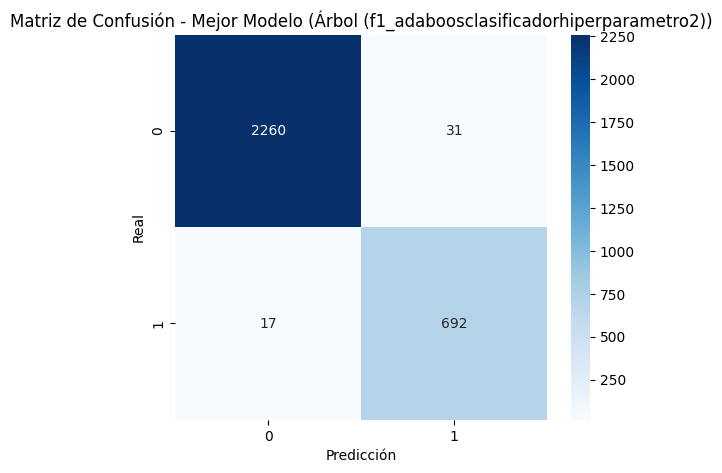

In [468]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, balanced_accuracy_score
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

# Evaluamos el modelo KNN
y_pred_KNN = knn.predict(X_test)
f1_KNN = classification_report(y_test, y_pred_KNN, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_KNN = roc_auc_score(y_test, y_pred_KNN)
balanced_acc_KNN = balanced_accuracy_score(y_test, y_pred_KNN)

# Evaluamos el modelo logistR
y_pred_logistR = classifierlogistic.predict(X_test)
f1_logistR = classification_report(y_test, y_pred_logistR, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_logistR = roc_auc_score(y_test, y_pred_logistR)
balanced_acc_logistR = balanced_accuracy_score(y_test, y_pred_logistR)

# Evaluamos el modelo Softmax
y_pred_Softmax = classifiersofmax.predict(X_test)
f1_Softmax = classification_report(y_test, y_pred_Softmax, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_Softmax = roc_auc_score(y_test, y_pred_Softmax)
balanced_acc_Softmax = balanced_accuracy_score(y_test, y_pred_Softmax)

# Evaluamos el modelo svm
y_pred_svm = svmLineal.predict(X_test)
f1_svm = classification_report(y_test, y_pred_svm, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_svm = roc_auc_score(y_test, y_pred_svm)
balanced_acc_svm = balanced_accuracy_score(y_test, y_pred_svm)

# Evaluamos el modelo Naive Bayes
y_pred_Naive_Bayes = modelNB.predict(X_test)
f1_Naive_Bayes= classification_report(y_test, y_pred_Naive_Bayes, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_Naive_Bayes = roc_auc_score(y_test, y_pred_Naive_Bayes)
balanced_acc_Naive_Bayes= balanced_accuracy_score(y_test, y_pred_Naive_Bayes)


# Evaluamos el modelo bgclasificadorhiperparámetro1
y_pred_bgclasificadorhiperparámetro1 = bgclasificadorhiperparámetro1.predict(X_test)
f1_bgclasificadorhiperparámetro1 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro1 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro1)
balanced_acc_bgclasificadorhiperparámetro1 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro1)

# Evaluamos el modelo bgclasificadorhiperparámetro2
y_pred_bgclasificadorhiperparámetro2 = bgclasificadorhiperparámetro2.predict(X_test)
f1_bgclasificadorhiperparámetro2 = classification_report(y_test, y_pred_bgclasificadorhiperparámetro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorhiperparámetro2 = roc_auc_score(y_test, y_pred_bgclasificadorhiperparámetro2)
balanced_acc_bgclasificadorhiperparámetro2 = balanced_accuracy_score(y_test, y_pred_bgclasificadorhiperparámetro2)


# Evaluamos el modelo adaboosclasificadorhiperparametro1
y_pred_adaboosclasificadorhiperparametro1 = adaboosclasificadorhiperparametro1.predict(X_test)
f1_adaboosclasificadorhiperparametro1 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro1, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro1 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro1)
balanced_acc_adaboosclasificadorhiperparametro1 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro1)

# Evaluamos el modelo adaboosclasificadorhiperparametro2
y_pred_adaboosclasificadorhiperparametro2 = adaboosclasificadorhiperparametro2.predict(X_test)
f1_adaboosclasificadorhiperparametro2 = classification_report(y_test, y_pred_adaboosclasificadorhiperparametro2, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_adaboosclasificadorhiperparametro2 = roc_auc_score(y_test, y_pred_adaboosclasificadorhiperparametro2)
balanced_acc_adaboosclasificadorhiperparametro2 = balanced_accuracy_score(y_test, y_pred_adaboosclasificadorhiperparametro2)

# Evaluamos el modelo por defecto (Gini)
y_pred_gini = clf_tree.predict(X_test)
f1_gini = classification_report(y_test, y_pred_gini, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_gini = roc_auc_score(y_test, y_pred_gini)
balanced_acc_gini = balanced_accuracy_score(y_test, y_pred_gini)

# Evaluamos el modelo con "maxdepth=7"
y_pred_maxdepth = clf_tree_maxdepth.predict(X_test)
f1_maxdepth = classification_report(y_test, y_pred_maxdepth, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_maxdepth = roc_auc_score(y_test, y_pred_maxdepth)
balanced_acc_maxdepth = balanced_accuracy_score(y_test, y_pred_maxdepth)

# Evaluamos el modelo con "entropy"
y_pred_entropy = clf_tree_entropy.predict(X_test)
f1_entropy = classification_report(y_test, y_pred_entropy, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_entropy = roc_auc_score(y_test, y_pred_entropy)
balanced_acc_entropy = balanced_accuracy_score(y_test, y_pred_entropy)


# Evaluamos el modelo con "BoostingGridSearchCV"
y_pred_BoostingGridSearchCV = BoostingGridSearchCV.predict(X_test)
f1_BoostingGridSearchCV = classification_report(y_test, y_pred_BoostingGridSearchCV, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_BoostingGridSearchCV = roc_auc_score(y_test, y_pred_BoostingGridSearchCV)
balanced_acc_BoostingGridSearchCV = balanced_accuracy_score(y_test, y_pred_BoostingGridSearchCV)

# Evaluamos el modelo con "bgclasificadorRandomSerach"
y_pred_bgclasificadorRandomSerach = bgclasificadorRandomSerach.predict(X_test)
f1_bgclasificadorRandomSerach = classification_report(y_test, y_pred_bgclasificadorRandomSerach, output_dict=True)["weighted avg"]["f1-score"]
roc_auc_bgclasificadorRandomSerach = roc_auc_score(y_test, y_pred_bgclasificadorRandomSerach)
balanced_acc_bgclasificadorRandomSerach = balanced_accuracy_score(y_test, y_pred_bgclasificadorRandomSerach)


# Mostramos las métricas en un DataFrame
resultados = pd.DataFrame({
    "Modelo": ["bgclasificadorRandomSerach","BoostingGridSearchCV","Naive Bayes", "KNN", "logistR","Softmax","SVM","Árbol (Gini)", "Árbol (Entropy)", "Árbol (MaxDepth=3)","Árbol (f1_bgclasificadorhiperparámetro1)", "Árbol (f1_bgclasificadorhiperparámetro2)", "Árbol (f1_adaboosclasificadorhiperparametro1)", "Árbol (f1_adaboosclasificadorhiperparametro2)"],
    "F1-Score": [f1_BoostingGridSearchCV, f1_bgclasificadorRandomSerach, f1_Naive_Bayes, f1_KNN, f1_logistR, f1_Softmax, f1_svm, f1_gini, f1_entropy, f1_maxdepth,f1_bgclasificadorhiperparámetro1, f1_bgclasificadorhiperparámetro2, f1_adaboosclasificadorhiperparametro1, f1_adaboosclasificadorhiperparametro2],
    "ROC-AUC": [roc_auc_BoostingGridSearchCV, roc_auc_bgclasificadorRandomSerach, roc_auc_Naive_Bayes, roc_auc_KNN, roc_auc_logistR, roc_auc_Softmax, roc_auc_svm, roc_auc_gini, roc_auc_entropy, roc_auc_maxdepth,roc_auc_bgclasificadorhiperparámetro1, roc_auc_bgclasificadorhiperparámetro2, roc_auc_adaboosclasificadorhiperparametro1, roc_auc_adaboosclasificadorhiperparametro2],
    "Balanced Accuracy": [balanced_acc_BoostingGridSearchCV, balanced_acc_bgclasificadorRandomSerach, balanced_acc_Naive_Bayes, balanced_acc_KNN, balanced_acc_logistR, balanced_acc_Softmax, roc_auc_svm, balanced_acc_gini, balanced_acc_entropy, balanced_acc_maxdepth,balanced_acc_bgclasificadorhiperparámetro1, balanced_acc_bgclasificadorhiperparámetro2, balanced_acc_adaboosclasificadorhiperparametro1,balanced_acc_adaboosclasificadorhiperparametro2]
})

print(resultados)

# Seleccionamos el mejor modelo según F1-score
mejores_valores = resultados["F1-Score"].idxmax()
mejor_modelo = resultados.loc[mejores_valores, "Modelo"]

if mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro1)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro1
elif mejor_modelo == "Árbol (f1_bgclasificadorhiperparámetro2)":
    y_pred_mejor = y_pred_bgclasificadorhiperparámetro2
elif mejor_modelo =="Árbol (f1_adaboosclasificadorhiperparametro1)":
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro1
elif mejor_modelo =="Árbol (f1_adaboosclasificadorhiperparametro2)":
    y_pred_mejor = y_pred_adaboosclasificadorhiperparametro2
elif mejor_modelo == "Árbol (Gini)":
    y_pred_mejor = y_pred_gini
elif mejor_modelo == "Árbol (Entropy)":
    y_pred_mejor = y_pred_entropy
elif mejor_modelo == "Árbol (MaxDepth=3)":
    y_pred_mejor = y_pred_maxdepth
elif mejor_modelo == "KNN":
    y_pred_mejor = y_pred_KNN
elif mejor_modelo == "logistR":
    y_pred_mejor = y_pred_logistR
elif mejor_modelo == "Softmax":
    y_pred_mejor = y_pred_Softmax
elif mejor_modelo == "SVM":
    y_pred_mejor = y_pred_svm
elif mejor_modelo == "bgclasificadorRandomSerach":
    y_pred_mejor = y_pred_bgclasificadorRandomSerach
elif mejor_modelo == "BoostingGridSearchCV":
    y_pred_mejor = y_pred_BoostingGridSearchCV
else:
    y_pred_mejor = y_pred_Naive_Bayes

# Graficamos la matriz de confusión del mejor modelo
plt.figure(figsize=(6,5))
sns.heatmap(confusion_matrix(y_test, y_pred_mejor), annot=True, fmt="d", cmap="Blues")
plt.title(f"Matriz de Confusión - Mejor Modelo ({mejor_modelo})")
plt.xlabel("Predicción")
plt.ylabel("Real")
plt.show()


In [ ]:
#adaboosclasificadorhiperparametro2 = AdaBoostClassifier(
#    estimator=DecisionTreeClassifier(max_depth=50),
#    n_estimators=600,  # Número de estimadores en el conjunto
#    learning_rate=0.5,  # Tasa de aprendizaje
#    random_state=123
#    )

El modelo "**adaboosclasificadorhiperparametro2**" presenta los mejores valores en todas las métricas, lo que indica que tiene el mejor rendimiento en términos de precisión, discriminación y balance entre clases.